___

<p style="text-align: center;"><img src="https://docs.google.com/uc?id=1lY0Uj5R04yMY3-ZppPWxqCr5pvBLYPnV" class="img-fluid" alt="CLRSWY"></p>

___

# WELCOME!

In this project, you must apply EDA processes for the development of predictive models. Handling outliers, domain knowledge and feature engineering will be challenges.

Also, this project aims to improve your ability to implement algorithms for Multi-Class Classification. Thus, you will have the opportunity to implement many algorithms commonly used for Multi-Class Classification problems.

Before diving into the project, please take a look at the determines and tasks.

# Determines

The 2012 US Army Anthropometric Survey (ANSUR II) was executed by the Natick Soldier Research, Development and Engineering Center (NSRDEC) from October 2010 to April 2012 and is comprised of personnel representing the total US Army force to include the US Army Active Duty, Reserves, and National Guard. In addition to the anthropometric and demographic data described below, the ANSUR II database also consists of 3D whole body, foot, and head scans of Soldier participants. These 3D data are not publicly available out of respect for the privacy of ANSUR II participants. The data from this survey are used for a wide range of equipment design, sizing, and tariffing applications within the military and has many potential commercial, industrial, and academic applications.

The ANSUR II working databases contain 93 anthropometric measurements which were directly measured, and 15 demographic/administrative variables explained below. The ANSUR II Male working database contains a total sample of 4,082 subjects. The ANSUR II Female working database contains a total sample of 1,986 subjects.


DATA DICT:
https://data.world/datamil/ansur-ii-data-dictionary/workspace/file?filename=ANSUR+II+Databases+Overview.pdf

---

To achieve high prediction success, you must understand the data well and develop different approaches that can affect the dependent variable.

Firstly, try to understand the dataset column by column using pandas module. Do research within the scope of domain (body scales, and race characteristics) knowledge on the internet to get to know the data set in the fastest way. 

You will implement ***Logistic Regression, Support Vector Machine, XGBoost, Random Forest*** algorithms. Also, evaluate the success of your models with appropriate performance metrics.

At the end of the project, choose the most successful model and try to enhance the scores with ***SMOTE*** make it ready to deploy. Furthermore, use ***SHAP*** to explain how the best model you choose works.

# Tasks

#### 1. Exploratory Data Analysis (EDA)
- Import Libraries, Load Dataset, Exploring Data

    *i. Import Libraries*
    
    *ii. Ingest Data *
    
    *iii. Explore Data*
    
    *iv. Outlier Detection*
    
    *v.  Drop unnecessary features*

#### 2. Data Preprocessing
- Scale (if needed)
- Separete the data frame for evaluation purposes

#### 3. Multi-class Classification
- Import libraries
- Implement SVM Classifer
- Implement Decision Tree Classifier
- Implement Random Forest Classifer
- Implement XGBoost Classifer
- Compare The Models



# EDA
- Drop unnecessary colums
- Drop DODRace class if value count below 500 (we assume that our data model can't learn if it is below 500)

## Import Libraries
Besides Numpy and Pandas, you need to import the necessary modules for data visualization, data preprocessing, Model building and tuning.

*Note: Check out the course materials.*

In [69]:
# libraries for EDA
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly
import plotly.express as px
import cufflinks as cf
#Enabling the offline mode for interactive plotting locally
from plotly.offline import download_plotlyjs,init_notebook_mode,plot,iplot
init_notebook_mode(connected=True)
cf.go_offline()
#To display the plots
%matplotlib inline

# sklearn library for machine learning algorithms, data preprocessing, and evaluation
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler
from sklearn.model_selection import train_test_split, GridSearchCV, cross_validate
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix, log_loss, recall_score, accuracy_score, precision_score, f1_score

# yellowbrick library for visualizing the model performance
from yellowbrick.classifier import ConfusionMatrix
from yellowbrick.cluster import KElbowVisualizer 

from sklearn.pipeline import Pipeline
# to get rid of the warnings
import warnings
warnings.filterwarnings("ignore")
warnings.warn("this will not show")


# to display mac columns and rows
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [70]:
# !pip install cufflinks

## Ingest Data from links below and make a dataframe
- Soldiers Male : https://query.data.world/s/h3pbhckz5ck4rc7qmt2wlknlnn7esr
- Soldiers Female : https://query.data.world/s/sq27zz4hawg32yfxksqwijxmpwmynq

In [71]:
import pandas as pd
df_male = pd.read_csv('https://query.data.world/s/c52mdq465v77acbuyoxdq4cctjrfye?dws=00000', encoding='latin-1')
df_female = pd.read_csv('https://query.data.world/s/bydb7flh376go6ao5maitsbfzyuukl?dws=00000', encoding='latin-1')


In [72]:
# check the dataset
display(df_male.shape, df_female.shape)

(4082, 108)

(1986, 108)

In [73]:
df_male.head()

,subjectid,abdominalextensiondepthsitting,acromialheight,acromionradialelength,anklecircumference,axillaheight,balloffootcircumference,balloffootlength,biacromialbreadth,bicepscircumferenceflexed,bicristalbreadth,bideltoidbreadth,bimalleolarbreadth,bitragionchinarc,bitragionsubmandibulararc,bizygomaticbreadth,buttockcircumference,buttockdepth,buttockheight,buttockkneelength,buttockpopliteallength,calfcircumference,cervicaleheight,chestbreadth,chestcircumference,chestdepth,chestheight,crotchheight,crotchlengthomphalion,crotchlengthposterioromphalion,earbreadth,earlength,earprotrusion,elbowrestheight,eyeheightsitting,footbreadthhorizontal,footlength,forearmcenterofgriplength,forearmcircumferenceflexed,forearmforearmbreadth,forearmhandlength,functionalleglength,handbreadth,handcircumference,handlength,headbreadth,headcircumference,headlength,heelanklecircumference,heelbreadth,hipbreadth,hipbreadthsitting,iliocristaleheight,interpupillarybreadth,interscyei,interscyeii,kneeheightmidpatella,kneeheightsitting,lateralfemoralepicondyleheight,lateralmalleolusheight,lowerthighcircumference,mentonsellionlength,neckcircumference,neckcircumferencebase,overheadfingertipreachsitting,palmlength,poplitealheight,radialestylionlength,shouldercircumference,shoulderelbowlength,shoulderlength,sittingheight,sleevelengthspinewrist,sleeveoutseam,span,stature,suprasternaleheight,tenthribheight,thighcircumference,thighclearance,thumbtipreach,tibialheight,tragiontopofhead,trochanterionheight,verticaltrunkcircumferenceusa,waistbacklength,waistbreadth,waistcircumference,waistdepth,waistfrontlengthsitting,waistheightomphalion,weightkg,wristcircumference,wristheight,Gender,Date,Installation,Component,Branch,PrimaryMOS,SubjectsBirthLocation,SubjectNumericRace,Ethnicity,DODRace,Age,Heightin,Weightlbs,WritingPreference
0,10027,266,1467,337,222,1347,253,202,401,369,274,493,71,319,291,142,979,240,882,619,509,373,1535,291,1074,259,1292,877,607,351,36,71,19,247,802,101,273,349,299,575,477,1136,90,214,193,150,583,206,326,70,332,366,1071,685,422,441,502,560,500,77,391,118,400,436,1447,113,437,273,1151,368,145,928,883,600,1782,1776,1449,1092,610,164,786,491,140,919,1700,501,329,933,240,440,1054,815,175,853,Male,4-Oct-10,Fort Hood,Regular Army,Combat Arms,19D,North Dakota,1,NaN,1,41,71,180,Right hand
1,10032,233,1395,326,220,1293,245,193,394,338,257,479,67,344,320,135,944,232,870,584,468,357,1471,269,1021,253,1244,851,615,376,33,62,18,232,781,98,263,348,289,523,476,1096,86,203,195,146,568,201,334,72,312,356,1046,620,441,447,490,540,488,73,371,131,380,420,1380,118,417,254,1119,353,141,884,868,564,1745,1702,1387,1076,572,169,822,476,120,918,1627,432,316,870,225,371,1054,726,167,815,Male,4-Oct-10,Fort Hood,Regular Army,Combat Support,68W,New York,1,NaN,1,35,68,160,Left hand
2,10033,287,1430,341,230,1327,256,196,427,408,261,544,75,345,330,135,1054,258,901,623,506,412,1501,288,1120,267,1288,854,636,359,40,61,23,237,810,103,270,355,357,575,491,1115,93,220,203,148,573,202,356,70,349,393,1053,665,462,475,496,556,482,72,409,123,403,434,1447,121,431,268,1276,367,167,917,910,604,1867,1735,1438,1105,685,198,807,477,125,918,1678,472,329,964,255,411,1041,929,180,831,Male,4-Oct-10,Fort Hood,Regular Army,Combat Support,68W,New York,2,NaN,2,42,68,205,Left hand
3,10092,234,1347,310,230,1239,262,199,401,359,262,518,73,328,309,143,991,242,821,560,437,395,1423,296,1114,262,1205,769,590,341,39,66,25,272,794,106,267,352,318,593,467,1034,91,217,194,158,576,199,341,68,338,367,986,640,458,461,460,511,452,76,393,106,407,446,1357,118,393,249,1155,330,148,903,848,550,1708,1655,1346,1021,604,180,803,445,127,847,1625,461,315,857,205,399,968,794,176,793,Male,12-Oct-10,Fort Hood,Regular Army,Combat Service Support,88M,Wisconsin,1,NaN,1,31,66,175,Right hand
4,10093,250,1585,372,247,1478,267,224,435,356,263,524,80,340,310,138,1029,275,1080,706,567,425,1684,304,1048,232,1452,1014,682,382,32,56,19,188,814,111,305,399,324,605,550,1279,94,222,218,153,566,197,374,69,332,372,1251,675,481,505,612,666,585,85,458

In [74]:
df_female.head()

,SubjectId,abdominalextensiondepthsitting,acromialheight,acromionradialelength,anklecircumference,axillaheight,balloffootcircumference,balloffootlength,biacromialbreadth,bicepscircumferenceflexed,bicristalbreadth,bideltoidbreadth,bimalleolarbreadth,bitragionchinarc,bitragionsubmandibulararc,bizygomaticbreadth,buttockcircumference,buttockdepth,buttockheight,buttockkneelength,buttockpopliteallength,calfcircumference,cervicaleheight,chestbreadth,chestcircumference,chestdepth,chestheight,crotchheight,crotchlengthomphalion,crotchlengthposterioromphalion,earbreadth,earlength,earprotrusion,elbowrestheight,eyeheightsitting,footbreadthhorizontal,footlength,forearmcenterofgriplength,forearmcircumferenceflexed,forearmforearmbreadth,forearmhandlength,functionalleglength,handbreadth,handcircumference,handlength,headbreadth,headcircumference,headlength,heelanklecircumference,heelbreadth,hipbreadth,hipbreadthsitting,iliocristaleheight,interpupillarybreadth,interscyei,interscyeii,kneeheightmidpatella,kneeheightsitting,lateralfemoralepicondyleheight,lateralmalleolusheight,lowerthighcircumference,mentonsellionlength,neckcircumference,neckcircumferencebase,overheadfingertipreachsitting,palmlength,poplitealheight,radialestylionlength,shouldercircumference,shoulderelbowlength,shoulderlength,sittingheight,sleevelengthspinewrist,sleeveoutseam,span,stature,suprasternaleheight,tenthribheight,thighcircumference,thighclearance,thumbtipreach,tibialheight,tragiontopofhead,trochanterionheight,verticaltrunkcircumferenceusa,waistbacklength,waistbreadth,waistcircumference,waistdepth,waistfrontlengthsitting,waistheightomphalion,weightkg,wristcircumference,wristheight,Gender,Date,Installation,Component,Branch,PrimaryMOS,SubjectsBirthLocation,SubjectNumericRace,Ethnicity,DODRace,Age,Heightin,Weightlbs,WritingPreference
0,10037,231,1282,301,204,1180,222,177,373,315,263,466,65,338,301,141,1011,223,836,587,476,360,1336,274,922,245,1095,759,557,310,35,65,16,220,713,91,246,316,265,517,432,1028,75,182,184,141,548,191,314,69,345,388,966,645,363,399,435,496,447,55,404,118,335,368,1268,113,362,235,1062,327,148,803,809,513,1647,1560,1280,1013,622,174,736,430,110,844,1488,406,295,850,217,345,942,657,152,756,Female,5-Oct-10,Fort Hood,Regular Army,Combat Support,92Y,Germany,2,NaN,2,26,61,142,Right hand
1,10038,194,1379,320,207,1292,225,178,372,272,250,430,64,294,270,126,893,186,900,583,483,350,1440,261,839,206,1234,835,549,329,32,60,23,208,726,91,249,341,247,468,463,1117,78,187,189,138,535,180,307,60,315,335,1048,595,340,375,483,532,492,69,334,115,302,345,1389,110,426,259,1014,346,142,835,810,575,1751,1665,1372,1107,524,152,771,475,125,901,1470,422,254,708,168,329,1032,534,155,815,Female,5-Oct-10,Fort Hood,Regular Army,Combat Service Support,25U,California,3,Mexican,3,21,64,120,Right hand
2,10042,183,1369,329,233,1271,237,196,397,300,276,450,69,309,270,128,987,204,861,583,466,384,1451,287,874,223,1226,821,643,374,36,65,26,204,790,100,265,343,262,488,469,1060,84,198,195,146,588,207,331,70,356,399,1043,655,345,399,470,530,469,64,401,135,325,369,1414,122,398,258,1049,362,164,904,855,568,1779,1711,1383,1089,577,164,814,458,129,882,1542,419,269,727,159,367,1035,663,162,799,Female,5-Oct-10,Fort Hood,Regular Army,Combat Service Support,35D,Texas,1,NaN,1,23,68,147,Right hand
3,10043,261,1356,306,214,1250,240,188,384,364,276,484,68,340,294,144,1012,253,897,599,471,372,1430,269,1008,285,1170,804,640,351,38,62,22,244,775,97,265,331,309,529,455,1069,80,192,186,153,593,206,332,68,337,402,1029,655,392,435,469,520,478,67,402,118,357,386,1329,115,394,250,1121,333,157,875,815,536,1708,1660,1358,1065,679,187,736,463,125,866,1627,451,302,923,235,371,999,782,173,818,Female,5-Oct-10,Fort Hood,Regular Army,Combat Service Support,25U,District of Columbia,8,Caribbean Islander,2,22,66,175,Right hand
4,10051,309,1303,308,214,1210,217,182,378,320,336,525,67,300,295,135,1281,284,811,607,467,433,1362,305,1089,290,1112,726,686,356,34,65,18,233,732,88,247,339,260,596,447,1039,78,183,187,140,522,181,308,63

In [75]:
# Concat the 2 datasets
# since the subjectid column is written differently in the datasets, this prevents concating properly. 
# They will be edited first
df_male.columns.to_list()

['subjectid',
 'abdominalextensiondepthsitting',
 'acromialheight',
 'acromionradialelength',
 'anklecircumference',
 'axillaheight',
 'balloffootcircumference',
 'balloffootlength',
 'biacromialbreadth',
 'bicepscircumferenceflexed',
 'bicristalbreadth',
 'bideltoidbreadth',
 'bimalleolarbreadth',
 'bitragionchinarc',
 'bitragionsubmandibulararc',
 'bizygomaticbreadth',
 'buttockcircumference',
 'buttockdepth',
 'buttockheight',
 'buttockkneelength',
 'buttockpopliteallength',
 'calfcircumference',
 'cervicaleheight',
 'chestbreadth',
 'chestcircumference',
 'chestdepth',
 'chestheight',
 'crotchheight',
 'crotchlengthomphalion',
 'crotchlengthposterioromphalion',
 'earbreadth',
 'earlength',
 'earprotrusion',
 'elbowrestheight',
 'eyeheightsitting',
 'footbreadthhorizontal',
 'footlength',
 'forearmcenterofgriplength',
 'forearmcircumferenceflexed',
 'forearmforearmbreadth',
 'forearmhandlength',
 'functionalleglength',
 'handbreadth',
 'handcircumference',
 'handlength',
 'headbread

In [76]:
df_female.columns.to_list()

['SubjectId',
 'abdominalextensiondepthsitting',
 'acromialheight',
 'acromionradialelength',
 'anklecircumference',
 'axillaheight',
 'balloffootcircumference',
 'balloffootlength',
 'biacromialbreadth',
 'bicepscircumferenceflexed',
 'bicristalbreadth',
 'bideltoidbreadth',
 'bimalleolarbreadth',
 'bitragionchinarc',
 'bitragionsubmandibulararc',
 'bizygomaticbreadth',
 'buttockcircumference',
 'buttockdepth',
 'buttockheight',
 'buttockkneelength',
 'buttockpopliteallength',
 'calfcircumference',
 'cervicaleheight',
 'chestbreadth',
 'chestcircumference',
 'chestdepth',
 'chestheight',
 'crotchheight',
 'crotchlengthomphalion',
 'crotchlengthposterioromphalion',
 'earbreadth',
 'earlength',
 'earprotrusion',
 'elbowrestheight',
 'eyeheightsitting',
 'footbreadthhorizontal',
 'footlength',
 'forearmcenterofgriplength',
 'forearmcircumferenceflexed',
 'forearmforearmbreadth',
 'forearmhandlength',
 'functionalleglength',
 'handbreadth',
 'handcircumference',
 'handlength',
 'headbread

In [77]:
# Column names >> list >> set and print the different column names in both datasets
print(set(df_male.columns.to_list()) - set(df_female.columns.to_list()))
print(set(df_female.columns.to_list()) - set(df_male.columns.to_list()))


{'subjectid'}
{'SubjectId'}


In [78]:
df_female.rename(columns = {'SubjectId':'subjectid'}, inplace = True)

In [79]:
# create a new dataset by merging both and get a deep copy
df0 = pd.concat([df_male, df_female], ignore_index=True)
df= df0.copy()
df.head(1)

,subjectid,abdominalextensiondepthsitting,acromialheight,acromionradialelength,anklecircumference,axillaheight,balloffootcircumference,balloffootlength,biacromialbreadth,bicepscircumferenceflexed,bicristalbreadth,bideltoidbreadth,bimalleolarbreadth,bitragionchinarc,bitragionsubmandibulararc,bizygomaticbreadth,buttockcircumference,buttockdepth,buttockheight,buttockkneelength,buttockpopliteallength,calfcircumference,cervicaleheight,chestbreadth,chestcircumference,chestdepth,chestheight,crotchheight,crotchlengthomphalion,crotchlengthposterioromphalion,earbreadth,earlength,earprotrusion,elbowrestheight,eyeheightsitting,footbreadthhorizontal,footlength,forearmcenterofgriplength,forearmcircumferenceflexed,forearmforearmbreadth,forearmhandlength,functionalleglength,handbreadth,handcircumference,handlength,headbreadth,headcircumference,headlength,heelanklecircumference,heelbreadth,hipbreadth,hipbreadthsitting,iliocristaleheight,interpupillarybreadth,interscyei,interscyeii,kneeheightmidpatella,kneeheightsitting,lateralfemoralepicondyleheight,lateralmalleolusheight,lowerthighcircumference,mentonsellionlength,neckcircumference,neckcircumferencebase,overheadfingertipreachsitting,palmlength,poplitealheight,radialestylionlength,shouldercircumference,shoulderelbowlength,shoulderlength,sittingheight,sleevelengthspinewrist,sleeveoutseam,span,stature,suprasternaleheight,tenthribheight,thighcircumference,thighclearance,thumbtipreach,tibialheight,tragiontopofhead,trochanterionheight,verticaltrunkcircumferenceusa,waistbacklength,waistbreadth,waistcircumference,waistdepth,waistfrontlengthsitting,waistheightomphalion,weightkg,wristcircumference,wristheight,Gender,Date,Installation,Component,Branch,PrimaryMOS,SubjectsBirthLocation,SubjectNumericRace,Ethnicity,DODRace,Age,Heightin,Weightlbs,WritingPreference
0,10027,266,1467,337,222,1347,253,202,401,369,274,493,71,319,291,142,979,240,882,619,509,373,1535,291,1074,259,1292,877,607,351,36,71,19,247,802,101,273,349,299,575,477,1136,90,214,193,150,583,206,326,70,332,366,1071,685,422,441,502,560,500,77,391,118,400,436,1447,113,437,273,1151,368,145,928,883,600,1782,1776,1449,1092,610,164,786,491,140,919,1700,501,329,933,240,440,1054,815,175,853,Male,4-Oct-10,Fort Hood,Regular Army,Combat Arms,19D,North Dakota,1,NaN,1,41,71,180,Right hand


In [80]:
df.shape

(6068, 108)

In [81]:
# drop wieghtkg since we have weightlbs
df.drop("weightkg", inplace=True, axis=1)

In [82]:
df.shape

(6068, 107)

## Explore Data




columns to be engineered:

- bmi from height weight???


**1. Drop the unnecessary columns**

columns to be dropped:

- subjectid
- SubjectNumericRace
- Ethnicity
- Date
- 'Installation',
- 'Component'
- 'Branch'
- SubjectsBirthLocation: cok daginik, farkli irklarin karisik yasadigi yerler. 100 alti kategori cok fazla. model ogrenemeyecegi icin drop.
- WritingPreference: bilimsel calismalara gore etkisi yok.
- PrimaryMOS


In [83]:
# primaryMOS check
df.PrimaryMOS.value_counts()

11B     671
88M     320
92A     288
91B     230
68W     222
92Y     211
42A     201
25U     196
31B     191
25B     176
12B     160
13B     139
35D     131
35M     128
74D     126
19D     123
92G     123
92F     119
25Q     113
35F      82
91D      73
25S      66
25L      62
11C      55
25A      53
19K      50
25N      49
12N      39
13D      39
11A      38
13F      38
91C      38
35G      36
92W      34
94F      33
90A      31
91J      30
91A      30
94E      29
89B      28
36B      27
91H      25
92S      24
21B      24
91L      23
35T      21
68A      20
88N      19
27D      19
11Z      19
68E      18
25W      18
92M      18
12C      17
12W      17
56M      17
15T      16
25P      15
13A      15
70B      15
91X      15
68J      15
35N      15
68K      14
35P      14
31E      14
13R      14
14J      14
66H      14
88Z      13
35L      13
88A      13
15W      13
15P      12
35X      12
25C      12
91E      12
13Z      11
351L     11
31A      11
14Z      10
12R      10
14T      10
14E 

In [84]:
# check SubjectsBirthLocation
df.SubjectsBirthLocation.value_counts()
# categories are too small and scattered for the model learning. drop

California                  446
New York                    420
Texas                       397
Indiana                     266
Oklahoma                    221
Illinois                    216
Florida                     210
Minnesota                   200
Michigan                    196
Mississippi                 194
Georgia                     170
Alabama                     164
South Carolina              161
North Carolina              149
Ohio                        142
Louisiana                   137
Pennsylvania                132
Virginia                    118
Massachusetts               112
Wisconsin                   102
Germany                      92
New Jersey                   89
Puerto Rico                  88
Arizona                      84
Missouri                     84
Colorado                     81
Maryland                     80
Tennessee                    74
Kentucky                     69
Washington                   66
Kansas                       63
South Da

In [85]:
# check SubjectNumericRace
df.SubjectNumericRace.value_counts()
# similar to DODrace target label. can be dropped

1        3561
2        1026
3         541
31        160
51        126
8         116
4         109
21         60
6          59
41         46
61         35
23         34
28         26
251        20
5          18
18         18
25         14
351        10
38          9
64          8
62          8
35          8
42          7
63          7
231         6
43          5
235         4
218         3
651         2
2351        2
318         2
641         2
451         2
423         2
431         2
2518        2
48          1
631         1
4251        1
428         1
238         1
358         1
425         1
42351       1
Name: SubjectNumericRace, dtype: int64

In [86]:
# check DODrace- Target
df.DODRace.value_counts()

1    3792
2    1298
3     679
4     188
6      59
5      49
8       3
Name: DODRace, dtype: int64

In [87]:
# drop the DODrace below 500 bec model can not learn from small groups and can be subject to the misclassification
df = df[df.DODRace<=3]

In [88]:
df0[df0.SubjectNumericRace <= 3]["SubjectNumericRace"].corr(df0["DODRace"])

0.9756985313158874

In [89]:
df0[df0["SubjectNumericRace"] >8]["DODRace"].value_counts()

1    213
2    171
3    152
4     49
5     30
6     20
8      3
Name: DODRace, dtype: int64

In [90]:
df0.SubjectNumericRace.corr(df0["DODRace"])

0.017987446186759636

In [91]:
df0["SubjectNumericRace"].isnull().sum()

0

In [92]:
# check ethnicity
df.Ethnicity.value_counts()

Mexican                                               356
Puerto Rican                                          183
Caribbean Islander                                    123
Cherokee                                               60
Dominican                                              32
Colombian                                              17
Cuban                                                  17
Salvadoran                                             16
Arab or Middle Eastern                                 16
Filipino                                               14
Japanese                                               12
Mexican Puerto Rican                                   10
Peruvian                                                9
Honduran                                                9
Panamanian                                              9
Dominican Puerto Rican                                  8
Ecuadorian                                              7
Nicaraguan    

In [93]:
# drop unnecessary attributes
df.drop(columns=["subjectid","SubjectNumericRace","Ethnicity","Date",'Installation','Component','Branch',
                 "SubjectsBirthLocation", "WritingPreference","PrimaryMOS"], axis=1, inplace=True)

In [94]:
# the only object attribute is Gender and it has only two categories. It will be converted to numerical
df.Gender.value_counts()

Male      3899
Female    1870
Name: Gender, dtype: int64

In [95]:
df.Gender = df.Gender.replace("Male", 0).replace("Female", 1)

In [96]:
# check updated df
df.shape

(5769, 97)

In [97]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5769 entries, 0 to 6067
Data columns (total 97 columns):
 #   Column                          Non-Null Count  Dtype
---  ------                          --------------  -----
 0   abdominalextensiondepthsitting  5769 non-null   int64
 1   acromialheight                  5769 non-null   int64
 2   acromionradialelength           5769 non-null   int64
 3   anklecircumference              5769 non-null   int64
 4   axillaheight                    5769 non-null   int64
 5   balloffootcircumference         5769 non-null   int64
 6   balloffootlength                5769 non-null   int64
 7   biacromialbreadth               5769 non-null   int64
 8   bicepscircumferenceflexed       5769 non-null   int64
 9   bicristalbreadth                5769 non-null   int64
 10  bideltoidbreadth                5769 non-null   int64
 11  bimalleolarbreadth              5769 non-null   int64
 12  bitragionchinarc                5769 non-null   int64
 13  bit

**Duplicate control**

In [98]:
# check duplicated values
df.duplicated().sum()

0

**Null Values control**

In [99]:
# check null values
df.isnull().sum()
# any null values

abdominalextensiondepthsitting    0
acromialheight                    0
acromionradialelength             0
anklecircumference                0
axillaheight                      0
balloffootcircumference           0
balloffootlength                  0
biacromialbreadth                 0
bicepscircumferenceflexed         0
bicristalbreadth                  0
bideltoidbreadth                  0
bimalleolarbreadth                0
bitragionchinarc                  0
bitragionsubmandibulararc         0
bizygomaticbreadth                0
buttockcircumference              0
buttockdepth                      0
buttockheight                     0
buttockkneelength                 0
buttockpopliteallength            0
calfcircumference                 0
cervicaleheight                   0
chestbreadth                      0
chestcircumference                0
chestdepth                        0
chestheight                       0
crotchheight                      0
crotchlengthomphalion       

**main statistical insights**

In [100]:
# check main statistics and distribution of the data
df.describe().T
# first insight from the mean and std show that there are not many outliers. will be checked with boxplots again.

,count,mean,std,min,25%,50%,75%,max
abdominalextensiondepthsitting,5769.0,247.254290,37.457748,155.0,220.0,243.0,272.0,451.0
acromialheight,5769.0,1408.630265,78.303123,1146.0,1353.0,1412.0,1464.0,1683.0
acromionradialelength,5769.0,328.071590,20.444554,249.0,314.0,328.0,342.0,393.0
anklecircumference,5769.0,225.201768,15.965783,156.0,214.0,225.0,235.0,293.0
axillaheight,5769.0,1301.902583,71.260913,1062.0,1252.0,1304.0,1351.0,1553.0
balloffootcircumference,5769.0,244.408043,16.803556,186.0,233.0,245.0,256.0,306.0
balloffootlength,5769.0,195.118911,13.379000,151.0,186.0,196.0,205.0,245.0
biacromialbreadth,5769.0,399.706015,30.124094,283.0,377.0,404.0,422.0,489.0
bicepscircumferenceflexed,5769.0,341.663027,41.270615,216.0,312.0,342.0,370.0,490.0
bicristalbreadth,5769.0,274.903449,19.239580,197.0,262.0,274.0,288.0,362.0


In [101]:
# check the correlation of features with DOD race
df.corr()["DODRace"]

abdominalextensiondepthsitting   -0.031860
acromialheight                   -0.217393
acromionradialelength            -0.158561
anklecircumference               -0.157784
axillaheight                     -0.205576
balloffootcircumference          -0.111249
balloffootlength                 -0.059867
biacromialbreadth                -0.113701
bicepscircumferenceflexed        -0.031438
bicristalbreadth                 -0.203874
bideltoidbreadth                 -0.070197
bimalleolarbreadth               -0.107319
bitragionchinarc                  0.083263
bitragionsubmandibulararc        -0.024195
bizygomaticbreadth                0.032559
buttockcircumference             -0.025066
buttockdepth                     -0.001344
buttockheight                    -0.098933
buttockkneelength                -0.066708
buttockpopliteallength           -0.043794
calfcircumference                -0.091895
cervicaleheight                  -0.215708
chestbreadth                     -0.155248
chestcircum

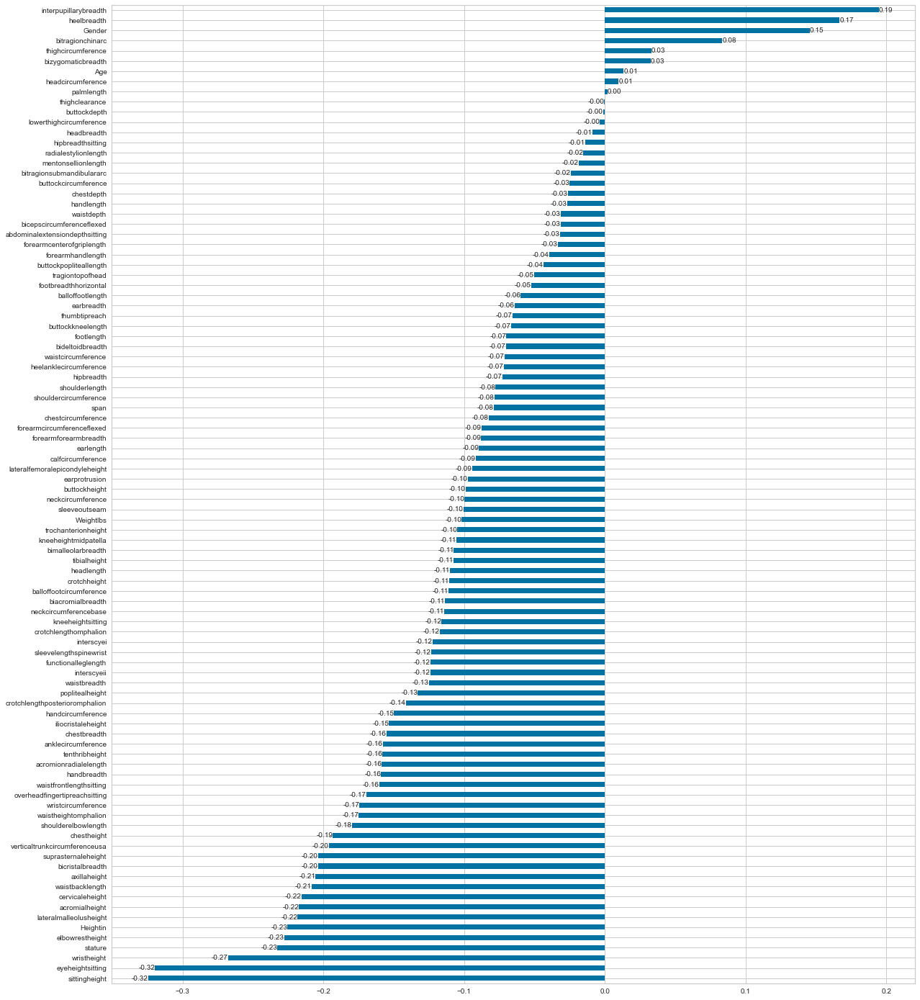

In [102]:
# check the correlation of the features with target throguh a barplot
plt.figure(figsize=(20,25))
ax = df.corr()["DODRace"].drop("DODRace").sort_values().plot.barh()
ax.bar_label(ax.containers[0], fmt='%.2f');

**OUTLIERS CHECK**

In [103]:
plt.figure(figsize=(30,50))
fig = px.box(df, color="DODRace", color_discrete_map={1:'#FF0000',2:'#00FF00', 3:'#000FF0'})
fig.show()

<Figure size 2160x3600 with 0 Axes>

In [104]:
def count_outliers(data):
    """
    This function counts the number of outliers in each numeric feature of a given dataset
    using Tukey's method.
    
    Parameters:
    -----------
    data : pandas DataFrame
        The dataset to analyze
    
    Returns:
    --------
    outlier_counts : pandas DataFrame
        A DataFrame containing the count of outliers for each numeric feature
    """
    # Create an empty DataFrame to store the outlier counts
    outlier_counts = pd.DataFrame(columns=['feature', 'count'])
    
    # Loop through each numeric feature in the dataset
    for feature in data.select_dtypes(include=np.number):
        # Calculate the first and third quartiles and the interquartile range
        q1 = data[feature].quantile(0.25)
        q3 = data[feature].quantile(0.75)
        iqr = q3 - q1
        
        # Calculate the lower and upper bounds for outliers
        lower_bound = q1 - 1.5 * iqr
        upper_bound = q3 + 1.5 * iqr
        
        # Count the number of outliers
        num_outliers = len(data[(data[feature] < lower_bound) | (data[feature] > upper_bound)])
        
        # Add the outlier count to the DataFrame
        outlier_counts = outlier_counts.append({'feature': feature, 'count': num_outliers}, ignore_index=True)
    
    # Return the DataFrame of outlier counts
    return outlier_counts

In [105]:
count_outliers(df)

,feature,count
0,abdominalextensiondepthsitting,46
1,acromialheight,14
2,acromionradialelength,31
3,anklecircumference,73
4,axillaheight,27
5,balloffootcircumference,23
6,balloffootlength,11
7,biacromialbreadth,1
8,bicepscircumferenceflexed,19
9,bicristalbreadth,57


**Multicolinearity** Scaling sonrası???

In [106]:
def color_red(val):
    
    if (val > 0.90 and val < 1) or (val < -0.90 and val > -1):
        color = 'red'
    else:
        color = 'black'
    return f'color: {color}'
# pd.DataFrame(df).corr().style.applymap(color_red)

In [107]:
df.corr()[(abs(df.corr())>= 0.9) & (abs(df.corr()) < 1)].any()

abdominalextensiondepthsitting     True
acromialheight                     True
acromionradialelength              True
anklecircumference                False
axillaheight                       True
balloffootcircumference            True
balloffootlength                   True
biacromialbreadth                  True
bicepscircumferenceflexed          True
bicristalbreadth                  False
bideltoidbreadth                   True
bimalleolarbreadth                False
bitragionchinarc                  False
bitragionsubmandibulararc         False
bizygomaticbreadth                False
buttockcircumference               True
buttockdepth                      False
buttockheight                      True
buttockkneelength                  True
buttockpopliteallength             True
calfcircumference                 False
cervicaleheight                    True
chestbreadth                      False
chestcircumference                False
chestdepth                        False


In [108]:
df.DODRace.value_counts()

1    3792
2    1298
3     679
Name: DODRace, dtype: int64

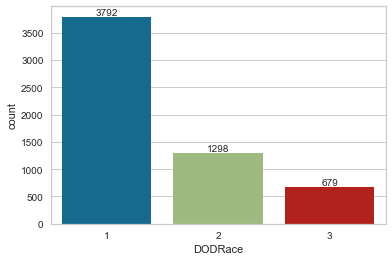

In [109]:
ax = sns.countplot(x='DODRace', data=df)
ax.bar_label(ax.containers[0]);
# imbalance 

# DATA Preprocessing
- In this step we divide our data to X(Features) and y(Target) then ,
- To train and evaluation purposes we create train and test sets,
- Lastly, scale our data if features not in same scale. Why?

**split the data**

In [110]:
X=df.drop(["DODRace"], axis=1)
y=df["DODRace"]

In [111]:
from sklearn.model_selection import train_test_split

# stratify=y : the data is imbalanced
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, stratify=y, random_state=42)

In [112]:
print(y.value_counts(normalize=True))
print()
print(y_train.value_counts(normalize=True))
print()
print(y_test.value_counts(normalize=True))

1    0.657306
2    0.224996
3    0.117698
Name: DODRace, dtype: float64

1    0.657421
2    0.224919
3    0.117660
Name: DODRace, dtype: float64

1    0.656846
2    0.225303
3    0.117851
Name: DODRace, dtype: float64


# Modelling
- Fit the model with train dataset
- Get predict from vanilla model on both train and test sets to examine if there is over/underfitting   
- Apply GridseachCV for both hyperparemeter tuning and sanity test of our model.
- Use hyperparameters that you find from gridsearch and make final prediction and evaluate the result according to chosen metric.

## 1. Logistic model

### Vanilla Logistic Model

In [113]:
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

operations = [("scaler", StandardScaler()), ("logistic", LogisticRegression())]

pipe_model = Pipeline(steps=operations)

pipe_model.fit(X_train, y_train)


Pipeline(steps=[('scaler', StandardScaler()),
                ('logistic', LogisticRegression())])

In [114]:
y_pred = pipe_model.predict(X_test)

In [115]:
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, ConfusionMatrixDisplay

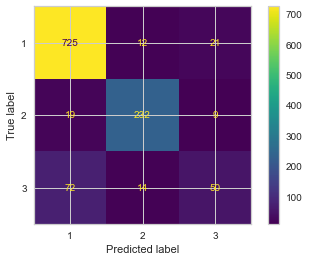

In [116]:
ConfusionMatrixDisplay.from_estimator(pipe_model, X_test, y_test);

In [117]:
def eval_metric(model, X_train, y_train, X_test, y_test):
    y_train_pred = model.predict(X_train)
    y_pred = model.predict(X_test)
    
    print("Test_Set")
    print(confusion_matrix(y_test, y_pred))
    print(classification_report(y_test, y_pred))
    print()
    print("Train_Set")
    print(confusion_matrix(y_train, y_train_pred))
    print(classification_report(y_train, y_train_pred))

In [118]:
# vanilla log reg
eval_metric(pipe_model, X_train, y_train, X_test, y_test)

# genel olarak overfitting yok
# ancak model ozellikle 3. sinif icin cok dusuk performans gosteriyor. recall ve precision degerleri cok dusuk
# CV ile asagida overfitting kontrolü yapilacak
# gridsearch ile bet parameters ile tekrar denenecek

Test_Set
[[725  12  21]
 [ 19 232   9]
 [ 72  14  50]]
              precision    recall  f1-score   support

           1       0.89      0.96      0.92       758
           2       0.90      0.89      0.90       260
           3       0.62      0.37      0.46       136

    accuracy                           0.87      1154
   macro avg       0.80      0.74      0.76      1154
weighted avg       0.86      0.87      0.86      1154


Train_Set
[[2924   26   84]
 [  57  961   20]
 [ 268   58  217]]
              precision    recall  f1-score   support

           1       0.90      0.96      0.93      3034
           2       0.92      0.93      0.92      1038
           3       0.68      0.40      0.50       543

    accuracy                           0.89      4615
   macro avg       0.83      0.76      0.79      4615
weighted avg       0.88      0.89      0.88      4615



In [119]:
# CV

from sklearn.model_selection import cross_validate

operations = [("scaler", StandardScaler()), ("logistic", LogisticRegression())]

model = Pipeline(steps=operations)

scores = cross_validate(model, X_train, y_train, scoring = ['accuracy', 'precision_weighted','recall_weighted',
                                                                   'f1_weighted'], cv = 10, return_train_score=True)
df_scores = pd.DataFrame(scores, index = range(1, 11))
df_scores.mean()[2:]

test_accuracy               0.874973
train_accuracy              0.889948
test_precision_weighted     0.861964
train_precision_weighted    0.879700
test_recall_weighted        0.874973
train_recall_weighted       0.889948
test_f1_weighted            0.863388
train_f1_weighted           0.880231
dtype: float64

In [120]:
# class prediction

y_pred=pipe_model.predict(X_test)
y_pred_proba = pipe_model.predict_proba(X_test)

test_data = pd.concat([X_test, y_test], axis=1)
test_data["pred"] = y_pred
test_data["pred_proba_1"] = y_pred_proba[:,0]
test_data["pred_proba_2"] = y_pred_proba[:,1]
test_data["pred_proba_3"] = y_pred_proba[:,2]
test_data[test_data.DODRace ==3].sample(10)

,abdominalextensiondepthsitting,acromialheight,acromionradialelength,anklecircumference,axillaheight,balloffootcircumference,balloffootlength,biacromialbreadth,bicepscircumferenceflexed,bicristalbreadth,bideltoidbreadth,bimalleolarbreadth,bitragionchinarc,bitragionsubmandibulararc,bizygomaticbreadth,buttockcircumference,buttockdepth,buttockheight,buttockkneelength,buttockpopliteallength,calfcircumference,cervicaleheight,chestbreadth,chestcircumference,chestdepth,chestheight,crotchheight,crotchlengthomphalion,crotchlengthposterioromphalion,earbreadth,earlength,earprotrusion,elbowrestheight,eyeheightsitting,footbreadthhorizontal,footlength,forearmcenterofgriplength,forearmcircumferenceflexed,forearmforearmbreadth,forearmhandlength,functionalleglength,handbreadth,handcircumference,handlength,headbreadth,headcircumference,headlength,heelanklecircumference,heelbreadth,hipbreadth,hipbreadthsitting,iliocristaleheight,interpupillarybreadth,interscyei,interscyeii,kneeheightmidpatella,kneeheightsitting,lateralfemoralepicondyleheight,lateralmalleolusheight,lowerthighcircumference,mentonsellionlength,neckcircumference,neckcircumferencebase,overheadfingertipreachsitting,palmlength,poplitealheight,radialestylionlength,shouldercircumference,shoulderelbowlength,shoulderlength,sittingheight,sleevelengthspinewrist,sleeveoutseam,span,stature,suprasternaleheight,tenthribheight,thighcircumference,thighclearance,thumbtipreach,tibialheight,tragiontopofhead,trochanterionheight,verticaltrunkcircumferenceusa,waistbacklength,waistbreadth,waistcircumference,waistdepth,waistfrontlengthsitting,waistheightomphalion,wristcircumference,wristheight,Gender,Age,Heightin,Weightlbs,DODRace,pred,pred_proba_1,pred_proba_2,pred_proba_3
1547,236,1432,335,214,1336,243,204,425,332,258,514,71,328,318,139,983,239,866,602,487,353,1502,279,1010,233,1288,842,600,342,33,63,17,252,805,94,279,340,292,558,472,1097,85,212,194,148,571,200,336,72,335,374,1078,610,427,464,477,549,485,68,388,121,379,430,1463,118,434,261,1188,364,157,913,905,587,1829,1752,1445,1114,589,175,800,467,122,892,1621,464,317,899,218,410,1060,170,852,0,22,70,170,3,1,0.845472,0.030872,0.123656
4591,238,1293,298,217,1190,224,181,352,299,271,455,64,303,277,135,1061,231,800,555,447,373,1348,268,925,251,1098,742,610,385,35,66,21,233,742,91,246,308,267,483,430,1009,77,188,176,147,552,188,311,63,374,434,954,640,385,395,426,490,428,66,405,111,329,373,1338,109,363,235,1004,322,135,855,798,520,1604,1583,1286,1015,648,168,700,411,117,791,1546,426,322,900,213,351,943,154,767,1,41,63,140,3,1,0.850032,0.002076,0.147892
2605,250,1294,288,231,1178,237,185,400,361,246,542,74,334,318,138,978,239,767,555,441,399,1365,302,1025,230,1160,749,558,297,33,56,17,277,756,95,242,305,311,610,414,977,85,197,165,141,524,179,329,68,320,358,930,595,465,470,444,493,434,64,396,117,395,430,1278,107,377,245,1189,312,137,865,837,517,1588,1583,1279,997,633,181,719,413,127,783,1578,478,314,928,254,356,925,167,795,0,24,63,155,3,3,0.176095,0.006368,0.817537
21,245,1370,309,222,1273,243,186,395,348,254,493,70,324,285,137,1013,249,820,577,462,380,1443,265,977,233,1262,785,659,394,33,65,21,282,797,97,254,331,299,554,450,1063,88,206,185,149,568,197,328,62,342,366,992,605,447,457,468,513,454,68,376,114,367,406,1399,110,401,254,1121,332,133,914,807,563,1695,1680,1374,1043,638,190,739,446,132,855,1693,437,319,880,216,385,1003,172,806,0,24,66,163,3,1,0.939396,0.004415,0.056189
4473,245,1385,320,257,1288,254,193,380,325,306,479,73,323,306,137,1063,235,875,612,492,409,1454,296,1028,271,1165,838,576,325,33,68,21,227,765,101,268,325,273,541,457,1100,84,206,195,160,605,205,340,72,371,435,1050,660,343,380,465,541,478,70,461,124,340,392,1422,118,398,255,1084,350,136,885,840,566,1748,1708,1388,1118,658,181,778,463,140,882,1590,472,335,970,221,382,1007,166,828,1,32,68,173,3,1,0.734452,0.035360,0.230188
3792,250,1466,341,225,1363,255,211,414,379,273,517,76,327,307,139,1024,231,926,658,530,392,1525,293,1048,260,1318,894,556,305,38,65,22,223,770,110,285,376,307,574,522,

### Logistic Model GridsearchCV

In [121]:
operations = [("scaler", StandardScaler()), ("logistic", LogisticRegression(max_iter=5000))]
 
model = Pipeline(steps=operations)

In [122]:
model.get_params()

{'memory': None,
 'steps': [('scaler', StandardScaler()),
  ('logistic', LogisticRegression(max_iter=5000))],
 'verbose': False,
 'scaler': StandardScaler(),
 'logistic': LogisticRegression(max_iter=5000),
 'scaler__copy': True,
 'scaler__with_mean': True,
 'scaler__with_std': True,
 'logistic__C': 1.0,
 'logistic__class_weight': None,
 'logistic__dual': False,
 'logistic__fit_intercept': True,
 'logistic__intercept_scaling': 1,
 'logistic__l1_ratio': None,
 'logistic__max_iter': 5000,
 'logistic__multi_class': 'auto',
 'logistic__n_jobs': None,
 'logistic__penalty': 'l2',
 'logistic__random_state': None,
 'logistic__solver': 'lbfgs',
 'logistic__tol': 0.0001,
 'logistic__verbose': 0,
 'logistic__warm_start': False}

In [123]:
# imabalanced datada en kotu performmans calss 3. bu nedenle class 3 recall'u ana hedefimiz
# gridsearche recall_3 verilir
from sklearn.metrics import make_scorer
from sklearn.metrics import precision_score, recall_score, accuracy_score, f1_score

f1_3 = make_scorer(f1_score, labels =[3], average = None)
precision_3 = make_scorer(precision_score, labels =[3], average = None)
recall_3 = make_scorer(recall_score, labels =[3], average = None)

# Cv'de kullanmak üzere her metric icin label:
# gridsearch sadece 1 skora gore optimizasyon yapacagi icin, altta scoringde recall_macro ile belirtecegiz
scoring = {"precision_3":precision_3, "recall_3":recall_3, "f1_3":f1_3}

In [124]:
penalty = ["l1", "l2"]
C = [0.01, 0.1, 1, 5, 16, 19, 22, 25]
solver = ['lbfgs', 'liblinear', 'newton-cg', 'newton-cholesky', 'sag', 'saga']

param_grid = {"logistic__penalty" : penalty,
             "logistic__C" : C,
             "logistic__solver" : solver}

In [125]:
# from sklearn.model_selection import RandomizedSearchCV

In [126]:

grid_model = GridSearchCV(model, param_grid = param_grid, cv=5, n_jobs=-1, scoring="recall_macro",return_train_score=True) 

In [127]:
# grid_model = GridSearchCV(model, param_grid = param_grid, cv=5, n_jobs=-1, return_train_score=True) 

In [128]:
grid_model.fit(X_train,y_train)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('logistic',
                                        LogisticRegression(max_iter=5000))]),
             n_jobs=-1,
             param_grid={'logistic__C': [0.01, 0.1, 1, 5, 16, 19, 22, 25],
                         'logistic__penalty': ['l1', 'l2'],
                         'logistic__solver': ['lbfgs', 'liblinear', 'newton-cg',
                                              'newton-cholesky', 'sag',
                                              'saga']},
             return_train_score=True, scoring='recall_macro')

In [129]:
grid_model.best_params_

{'logistic__C': 25, 'logistic__penalty': 'l2', 'logistic__solver': 'lbfgs'}

In [130]:
grid_model.best_estimator_

Pipeline(steps=[('scaler', StandardScaler()),
                ('logistic', LogisticRegression(C=25, max_iter=5000))])

In [131]:
pd.DataFrame(grid_model.cv_results_).loc[grid_model.best_index_, ["mean_test_score", "mean_train_score"]]

mean_test_score      0.74344
mean_train_score    0.771986
Name: 90, dtype: object

In [132]:
y_pred = grid_model.predict(X_test)
y_pred

array([1, 1, 2, ..., 2, 2, 1])

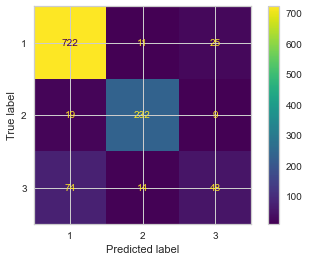

In [133]:
ConfusionMatrixDisplay.from_estimator(grid_model, X_test, y_test);
# total number of false predictions for sclass 3 has increased. Vanilla performs better

In [134]:
# log reg with best hyperparameteres
eval_metric(grid_model, X_train, y_train, X_test, y_test)
# test scores has decreased

Test_Set
[[722  11  25]
 [ 19 232   9]
 [ 74  14  48]]
              precision    recall  f1-score   support

           1       0.89      0.95      0.92       758
           2       0.90      0.89      0.90       260
           3       0.59      0.35      0.44       136

    accuracy                           0.87      1154
   macro avg       0.79      0.73      0.75      1154
weighted avg       0.85      0.87      0.86      1154


Train_Set
[[2924   24   86]
 [  57  960   21]
 [ 262   58  223]]
              precision    recall  f1-score   support

           1       0.90      0.96      0.93      3034
           2       0.92      0.92      0.92      1038
           3       0.68      0.41      0.51       543

    accuracy                           0.89      4615
   macro avg       0.83      0.77      0.79      4615
weighted avg       0.88      0.89      0.88      4615



**Precision Recall Curve for imbalanced data**

In [135]:
from sklearn.metrics import RocCurveDisplay, PrecisionRecallDisplay

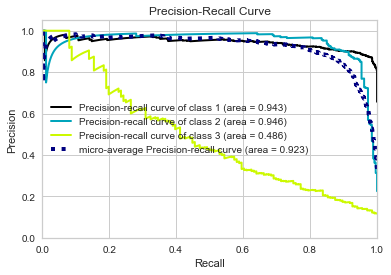

In [136]:
# PRECISION RECALL 
from scikitplot.metrics import plot_roc, precision_recall_curve
from scikitplot.metrics import plot_precision_recall

operations = [("scaler", StandardScaler()), ("logistic", LogisticRegression(C=19, max_iter=5000))]

model = Pipeline(steps=operations)

model.fit(X_train, y_train)

y_pred_proba = model.predict_proba(X_test)
    
plot_precision_recall(y_test, y_pred_proba)
plt.show();
# high performance for class 1 and class 2; slightly lower performance for class 3

Result: There is no overfitting for the log regression model. However, the prediction performance of the model decreases sharply for the class 3. In the same way, precision recall curve is only 0.48 for class 3, which means a very poor performance for the model. 

## 2. SVC

### Vanilla SVC model 

In [137]:
from sklearn.svm import SVC
from sklearn.metrics import classification_report,confusion_matrix

In [138]:
# scaling and pipeline

operations = [("scaler", StandardScaler()), ("SVC", SVC())]
pipe_model = Pipeline(steps=operations)

In [139]:
pipe_model.fit(X_train, y_train)

# Vanilla SVC
eval_metric(pipe_model, X_train, y_train, X_test, y_test)

# compared to logistic regression, SVC performs worse for all classes.
# overfitting

Test_Set
[[739  12   7]
 [ 23 234   3]
 [ 99  13  24]]
              precision    recall  f1-score   support

           1       0.86      0.97      0.91       758
           2       0.90      0.90      0.90       260
           3       0.71      0.18      0.28       136

    accuracy                           0.86      1154
   macro avg       0.82      0.68      0.70      1154
weighted avg       0.85      0.86      0.84      1154


Train_Set
[[3006   13   15]
 [  65  967    6]
 [ 327   44  172]]
              precision    recall  f1-score   support

           1       0.88      0.99      0.93      3034
           2       0.94      0.93      0.94      1038
           3       0.89      0.32      0.47       543

    accuracy                           0.90      4615
   macro avg       0.91      0.75      0.78      4615
weighted avg       0.90      0.90      0.88      4615



In [140]:
# check with cross validation

operations = [("scaler", StandardScaler()), ("SVC", SVC())]
pipe_model = Pipeline(steps=operations)

scores = cross_validate(pipe_model, 
                        X_train, 
                        y_train, 
                        scoring=['accuracy', 'precision','recall','f1'],
                        cv = 10,
                        return_train_score=True)
df_scores = pd.DataFrame(scores, index = range(1, 11))
df_scores.mean()[2:]

test_accuracy      0.869338
train_accuracy     0.896039
test_precision          NaN
train_precision         NaN
test_recall             NaN
train_recall            NaN
test_f1                 NaN
train_f1                NaN
dtype: float64

###  SVC Model GridsearchCV

In [141]:
# define the space for hyperparameters
param_grid = {'SVC__C': [0.001, 0.05, 0.01, 0.1],
              'SVC__gamma': ["scale", "auto", 0.2, 0.3],
              'SVC__kernel': ['rbf', 'linear'], 
              'SVC__class_weight': ["balanced", None]}

In [142]:
# set the operator order including scaler for pipeline and build SVC model by using pipeline
operations = [("scaler", StandardScaler()), ("SVC", SVC(probability=True))]
pipe_model = Pipeline(steps=operations)

# scores for imbalanced multiclass dataset-for CV
scoring = {
    'weighted_precision': make_scorer(precision_score, average='weighted'),
    'weighted_recall': make_scorer(recall_score, average='weighted'),
    'weighted_f1': make_scorer(f1_score, average='weighted'),
    'macro_f1': make_scorer(f1_score, average='macro')
}

# model
svm_model_grid = GridSearchCV(pipe_model, 
                              param_grid, 
                              scoring="recall_macro",
                              cv=10, 
                              n_jobs=-1,
                              return_train_score=True)

In [ ]:
# fit the train data
svm_model_grid.fit(X_train, y_train)


In [ ]:
# get the best estimators
svm_model_grid.best_estimator_

In [ ]:
# check overfitting
pd.DataFrame(svm_model_grid.cv_results_).loc[svm_model_grid.best_index_, ["mean_test_score", "mean_train_score"]]
# recall scores

In [ ]:
# SVC with best hyperparameters
eval_metric(svm_model_grid, X_train, y_train, X_test, y_test)

# recall has increased significantly for class 3 from 0.18 to 0.64. model can predict 86 of 136 truely. 
# train recall for class 3 is higher than test recall (0.74 to 0.64).
# recall for class 1 decreased sharply for class 1


In [ ]:
# with gridsearch, we don't need cv again, however if we want to see all metrics, we can implement
operations = [("scaler", StandardScaler()), 
              ("SVC", SVC(C= 0.01, kernel= 'linear', probability=True, 
                                                        class_weight="balanced"))]
# For kernel='linear', the value of gamma does not affect the model, as gamma is only used for non-linear kernels. 
# Therefore, the default value of gamma is not used here.

# rebuild the model with best hyperparameters found during gridsearch
model = Pipeline(steps=operations)

scores = cross_validate(model, 
                        X_train, 
                        y_train, 
                        scoring=scoring, 
                        cv = 10,
                        return_train_score=True)
df_scores = pd.DataFrame(scores, index = range(1, 11))
df_scores.mean()[2:]

# no overfitting

In [ ]:
# Precision recall display for SVM model

from scikitplot.metrics import plot_precision_recall


operations = [("scaler", StandardScaler()), 
              ("SVC", SVC(C= 0.01, kernel= 'linear', probability=True, 
                                                        class_weight="balanced"))]

model = Pipeline(steps=operations)

model.fit(X_train, y_train)

y_pred_proba = model.predict_proba(X_test)
    
plot_precision_recall(y_test, y_pred_proba)
plt.show();



In [ ]:
# target 0.5 ise  kabul edilebilir degil

## 3. RF

### Vanilla RF Model

In [ ]:
# import RF Classifier
from sklearn.ensemble import RandomForestClassifier

# define the operations for pipeline
# tree-based algorithms do not need scaling
# since the data is imbalanced: class_weight="balanced"
operations = [("RF_model", RandomForestClassifier(class_weight="balanced",random_state=101))]

# build pipe model
pipe_model = Pipeline(steps=operations)

# fit the train data
pipe_model.fit(X_train, y_train)

**Model Performance**

In [ ]:
from sklearn.metrics import confusion_matrix, classification_report,\
                            accuracy_score, recall_score, precision_score,\
                            f1_score

def eval_metric(model, X_train, y_train, X_test, y_test):
    y_train_pred = model.predict(X_train)
    y_pred = model.predict(X_test)
    
    print("Test_Set")
    print(confusion_matrix(y_test, y_pred))
    print(classification_report(y_test, y_pred))
    print()
    print("Train_Set")
    print(confusion_matrix(y_train, y_train_pred))
    print(classification_report(y_train, y_train_pred))

In [ ]:
# vanilla RF
eval_metric(pipe_model, X_train, y_train, X_test, y_test)

# as seen the scores in the vanilla RF model for the train data are pretty high; however the model
# performs very badly for the test data. Compared to the log reg and svm, recall scores of class 2 and class 3
# have decreased. For example, for class 3, it can predict only 5 out of 136 correctly.
# model is highly overfitted. It will be checked with cross val to be sure

In [ ]:
# cross validation
operations = [("RF_model", RandomForestClassifier(class_weight="balanced",random_state=101))]

model = Pipeline(steps=operations)

scores = cross_validate(model, 
                        X_train, 
                        y_train, 
                        scoring=["accuracy", 
                                 "precision_micro",
                                 "recall_micro", 
                                 "f1_micro"], 
                        cv = 10,
                        return_train_score=True)
df_scores = pd.DataFrame(scores, index = range(1, 11))
df_scores.mean()[2:]

# model is highly overfitted.

In [ ]:
# Model will be rebuilt by tuning the hyperparameteres to check if the scores can be improved

### RF Model GridsearchCV

Since the data is highly imbalanced and complex (with 98 features), the steps to tune the hyperparameters:

- relatively higher max_depth to allow for complex model to capture the patterns in the data, 
- relatively higher number of trees in the forest (n_estimators) to improve the robustness of the model. 
- relatively higher min_samples_split to prevent overfitting on the minority class.
- class_weight hyperparameter which can help the model to deal with class imbalance is set to 'balanced', 'balanced_subsample', and None to automatically adjust the weights inversely proportional to the class frequencies or sample frequencies respectively. 


In [ ]:
# they will be reset in line with the best estimators results below
param_grid = {'n_estimators': [150,200],   # 200,300,400          
              'max_features': [15, 20,  'sqrt'], # 5,10,15, sqrt
              'max_depth': [10,15], # 5,10,15 # default None takes the model to overfitting. thus, manual values are set
              'min_samples_split': [5,10],
              'min_samples_leaf': [1,5], # 1,5,10
              'class_weight': ['balanced', 'balanced_subsample', None]}

In [ ]:
# values counts for each classes
df.DODRace.value_counts()

In [ ]:
# how to set the class weights

n_samples = [3792, 1298, 679]
total_samples = sum(n_samples)
class_weight_RF = {i: total_samples / (len(n_samples) * n_samples[i]) for i in range(len(n_samples))}

In [ ]:
class_weight_RF

In [ ]:
# RF grid search for imbalanced multiclass data

from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import make_scorer
from sklearn.metrics import precision_score, recall_score, accuracy_score, f1_score
from sklearn.metrics import confusion_matrix, classification_report


model = RandomForestClassifier(class_weight=class_weight_RF,
                               random_state=101)
scoring = {
    'weighted_precision': make_scorer(precision_score, average='weighted', zero_division=0),
    'weighted_recall': make_scorer(recall_score, average='weighted', zero_division=0),
    'weighted_f1': make_scorer(f1_score, average='weighted', zero_division=0),
    'macro_f1': make_scorer(f1_score, average='macro', zero_division=0)
}

rf_grid_model = GridSearchCV(model, 
                             param_grid, 
                             scoring=scoring,
                             refit="weighted_recall",
                             n_jobs = -1, 
                             verbose=1).fit(X_train, y_train)

In [26]:
rf_grid_model.best_estimator_
# first results
# RandomForestClassifier(max_depth=10, max_features=15, min_samples_leaf=5,
                       # min_samples_split=5, n_estimators=200, random_state=101)

RandomForestClassifier(max_depth=15, max_features=15, min_samples_split=10,
                       n_estimators=150, random_state=101)

In [27]:
rf_grid_model.best_score_

0.8212351029252438

In [30]:
# RF with best hyperparameters
eval_metric(rf_grid_model, X_train, y_train, X_test, y_test)
# despite the improvement in the scores compared to RF without gridsearch, the model is still highly overfitted and
# performs very poorly for the 3rd class

Test_Set
[[735  20   3]
 [ 60 196   4]
 [114  14   8]]
              precision    recall  f1-score   support

           1       0.81      0.97      0.88       758
           2       0.85      0.75      0.80       260
           3       0.53      0.06      0.11       136

    accuracy                           0.81      1154
   macro avg       0.73      0.59      0.60      1154
weighted avg       0.79      0.81      0.77      1154


Train_Set
[[3034    0    0]
 [  42  996    0]
 [ 173    7  363]]
              precision    recall  f1-score   support

           1       0.93      1.00      0.97      3034
           2       0.99      0.96      0.98      1038
           3       1.00      0.67      0.80       543

    accuracy                           0.95      4615
   macro avg       0.98      0.88      0.91      4615
weighted avg       0.95      0.95      0.95      4615



In [31]:
# cross val with best hyperparameter scores and overfitting check
model = RandomForestClassifier(class_weight={1: 0.507120253164557, 2: 1.4815100154083205, 3: 2.8321060382916055}, 
                               # class_weight=class_weight_rf the labels are for class_weight_rf 0,1,2
                               # but cross val asks for 1,2,3 label. thus they are entered manually
                               max_depth=15, 
                               max_features=15,
                               max_samples=0.8, 
                               min_samples_leaf=5, 
                               n_estimators=200,
                               random_state=101)

scores = cross_validate(model, 
                        X_train, 
                        y_train, 
                        scoring=scoring,
                        cv=10, 
                        return_train_score=True)
df_scores = pd.DataFrame(scores, index = range(1, 11))

df_scores.mean()[2:]
# highly overfitted

test_weighted_precision     0.796513
train_weighted_precision    0.976517
test_weighted_recall        0.818196
train_weighted_recall       0.976478
test_weighted_f1            0.797589
train_weighted_f1           0.976464
test_macro_f1               0.663047
train_macro_f1              0.968388
dtype: float64

**ROC Curve and AUC**

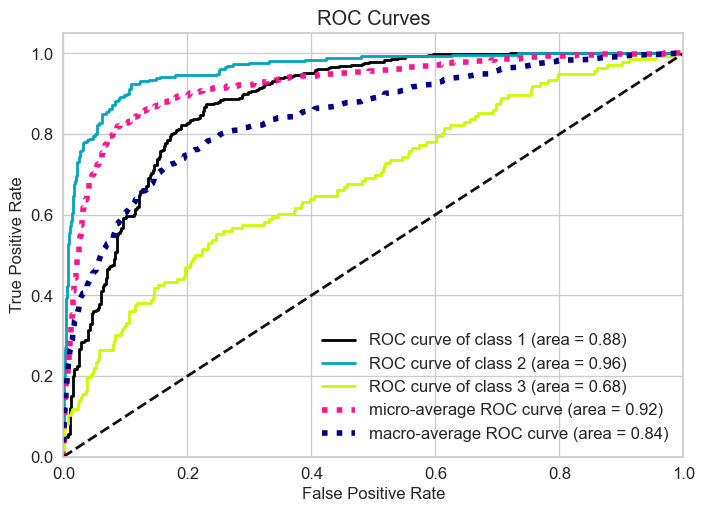

In [219]:
from scikitplot.metrics import plot_roc, precision_recall_curve

y_pred_proba = rf_grid_model.predict_proba(X_test)
    
plot_roc(y_test, y_pred_proba)
plt.show();

# relatively poor results for class 3; model performs well for class 2 and 3

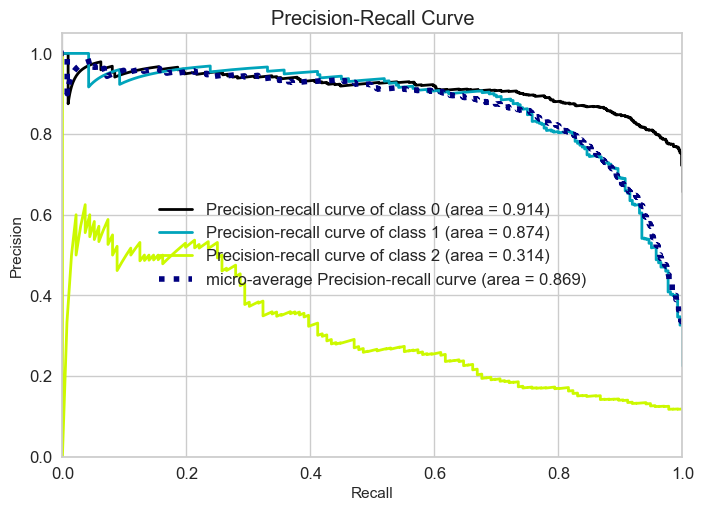

In [124]:
# Precision recall display for RF model

model = RandomForestClassifier(class_weight={0: 0.507120253164557, 1: 1.4815100154083205, 2: 2.8321060382916055}, 
                               max_depth=15, 
                               max_features=15,
                               max_samples=0.8, 
                               min_samples_leaf=5, 
                               n_estimators=200,
                               random_state=101)

model.fit(X_train, y_train)

y_pred_proba = model.predict_proba(X_test)
    
plot_precision_recall(y_test, y_pred_proba)
plt.show();

**FEATURE IMPORTANCE WITH RF**

In [38]:
rf_grid_model = RandomForestClassifier(class_weight={1: 0.507120253164557, 2: 1.4815100154083205, 3: 2.8321060382916055}, 
                               max_depth=15, 
                               max_features=15,
                               max_samples=0.8, 
                               min_samples_leaf=5, 
                               n_estimators=200,
                               random_state=101)

rf_grid_model.fit(X_train, y_train)

# feature importance bulduğumuz en iyi hyper parametreleri kullanmamız gerektiğini unutmayalım

RandomForestClassifier(class_weight={1: 0.507120253164557,
                                     2: 1.4815100154083205,
                                     3: 2.8321060382916055},
                       max_depth=15, max_features=15, max_samples=0.8,
                       min_samples_leaf=5, n_estimators=200, random_state=101)

In [39]:
rf_grid_model.feature_importances_

array([0.00493295, 0.00661655, 0.00580278, 0.00811419, 0.00698262,
       0.00486036, 0.00517863, 0.0051321 , 0.00741646, 0.03237707,
       0.00594677, 0.0045215 , 0.02047304, 0.00818611, 0.0101234 ,
       0.00582511, 0.00662112, 0.0165541 , 0.02933474, 0.03285978,
       0.00647382, 0.00785091, 0.00822556, 0.00706047, 0.00538588,
       0.00651932, 0.0106903 , 0.00702327, 0.00526062, 0.00415161,
       0.01961066, 0.0137585 , 0.03853951, 0.04445912, 0.0046541 ,
       0.00571462, 0.01495151, 0.00601061, 0.00559696, 0.01985917,
       0.00531161, 0.0047632 , 0.00627242, 0.01876863, 0.00549228,
       0.01667045, 0.00814072, 0.0052418 , 0.0289063 , 0.00614372,
       0.00591451, 0.00949406, 0.03207882, 0.0060499 , 0.00533867,
       0.00509157, 0.00453098, 0.00947274, 0.00917979, 0.00626586,
       0.00779042, 0.00695348, 0.00569873, 0.00526231, 0.01470221,
       0.0048291 , 0.01827685, 0.0064998 , 0.00725953, 0.00494069,
       0.05027851, 0.00554898, 0.00472045, 0.00844967, 0.01162

In [41]:
# get the feature names from X(independent features) and assign them together with the coefficients
# to a dataframe 

df_f_i = pd.DataFrame(data=rf_grid_model.feature_importances_, 
                      index=X.columns,
                      columns=["Feature Importance"])

# sort the features according to their importance for the Target
df_f_i = df_f_i.sort_values("Feature Importance", ascending=False)
df_f_i


,Feature Importance
sittingheight,0.050279
eyeheightsitting,0.044459
elbowrestheight,0.038540
buttockpopliteallength,0.032860
bicristalbreadth,0.032377
interpupillarybreadth,0.032079
buttockkneelength,0.029335
heelbreadth,0.028906
bitragionchinarc,0.020473
forearmhandlength,0.019859


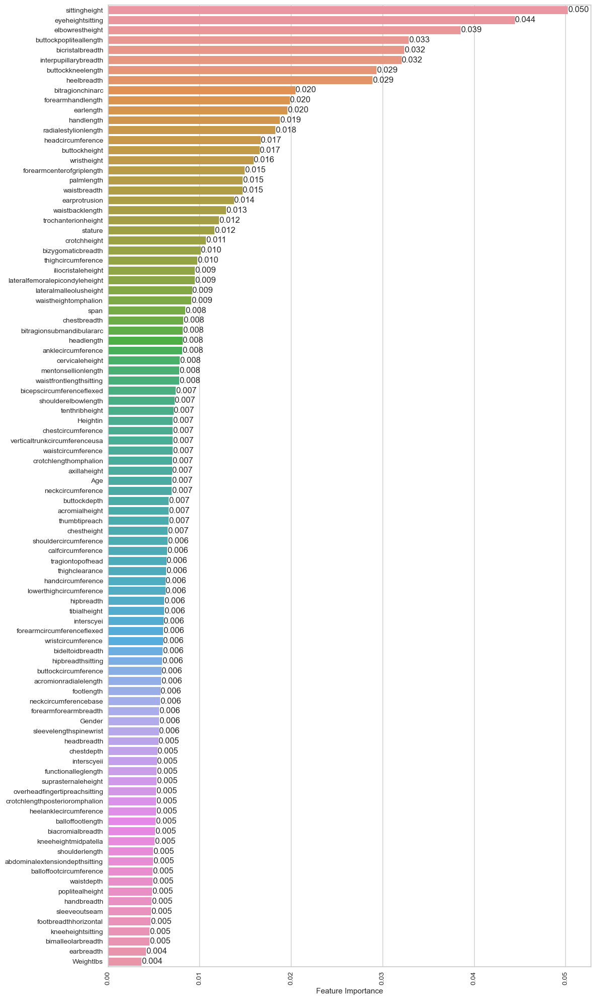

In [44]:
# visualize the feature importance
plt.figure(figsize=(12,20))
ax =sns.barplot(y = df_f_i.index, 
                x = 'Feature Importance', 
                data = df_f_i)
ax.bar_label(ax.containers[0],fmt="%.3f")
plt.xticks(rotation = 90)
plt.tight_layout()

## 4. XGBoost

### Vanilla XGBoost Model

In [95]:
# libraries
import xgboost as xgb

from xgboost import XGBClassifier

In [101]:
xgb = XGBClassifier()

# ValueError: Invalid classes inferred from unique values of `y`.  Expected: [0 1 2], got [1 2 3]
# Shift class labels down by one
y_train = np.array([label - 1 for label in y_train])
y_test = np.array([label - 1 for label in y_test])

xgb.fit(X_train, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=None, num_parallel_tree=None,
              objective='multi:softprob', predictor=None, ...)

In [102]:
# Vanilla XGBoost
eval_metric(xgb, X_train, y_train, X_test, y_test)
# poor performance for class 2(3) and highly overfitted

Test_Set
[[724  19  15]
 [ 29 223   8]
 [ 93  15  28]]
              precision    recall  f1-score   support

           0       0.86      0.96      0.90       758
           1       0.87      0.86      0.86       260
           2       0.55      0.21      0.30       136

    accuracy                           0.84      1154
   macro avg       0.76      0.67      0.69      1154
weighted avg       0.82      0.84      0.82      1154


Train_Set
[[3034    0    0]
 [   0 1038    0]
 [   0    0  543]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      3034
           1       1.00      1.00      1.00      1038
           2       1.00      1.00      1.00       543

    accuracy                           1.00      4615
   macro avg       1.00      1.00      1.00      4615
weighted avg       1.00      1.00      1.00      4615



In [103]:
# cross val
model = XGBClassifier(random_state=42)

scoring = {
    'weighted_precision': make_scorer(precision_score, average='weighted', zero_division=0),
    'weighted_recall': make_scorer(recall_score, average='weighted', zero_division=0),
    'weighted_f1': make_scorer(f1_score, average='weighted', zero_division=0),
    'macro_f1': make_scorer(f1_score, average='macro', zero_division=0)
}

scores = cross_validate(model,
                        X_train, 
                        y_train, 
                        scoring=scoring,
                        cv = 10, 
                        return_train_score=True)
df_scores = pd.DataFrame(scores, index = range(1, 11))
df_scores.mean()[2:]
# overfitted

test_weighted_precision     0.834988
train_weighted_precision    1.000000
test_weighted_recall        0.852007
train_weighted_recall       1.000000
test_weighted_f1            0.828729
train_weighted_f1           1.000000
test_macro_f1               0.697453
train_macro_f1              1.000000
dtype: float64

### XGBoost Model GridsearchCV

In [104]:
param_grid = {"n_estimators":[50, 100, 200],
              'max_depth':[3,4,5], 
              "learning_rate": [0.1, 0.2],
              "subsample":[0.5, 0.8, 1], 
              "colsample_bytree":[0.5,0.7, 1]}

In [105]:
xgb_model = XGBClassifier(random_state=42) # default random_state=42

In [ ]:
xgb_grid = GridSearchCV(xgb_model,
                        param_grid, 
                        scoring=scoring,
                        refit="weighted_recall",
                        verbose=1,
                        n_jobs=-1,
                        return_train_score=True)

xgb_grid.fit(X_train, y_train)

In [107]:
xgb_grid.best_params_

{'colsample_bytree': 1,
 'learning_rate': 0.2,
 'max_depth': 4,
 'n_estimators': 200,
 'subsample': 0.8}

In [108]:
xgb_grid.best_estimator_

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None, colsample_bytree=1,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, feature_types=None, gamma=None, gpu_id=None,
              grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.2, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=4, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=200, n_jobs=None, num_parallel_tree=None,
              objective='multi:softprob', predictor=None, ...)

In [112]:
print(pd.DataFrame(xgb_grid.cv_results_).columns)

Index(['mean_fit_time', 'std_fit_time', 'mean_score_time', 'std_score_time',
       'param_colsample_bytree', 'param_learning_rate', 'param_max_depth',
       'param_n_estimators', 'param_subsample', 'params',
       'split0_test_weighted_precision', 'split1_test_weighted_precision',
       'split2_test_weighted_precision', 'split3_test_weighted_precision',
       'split4_test_weighted_precision', 'mean_test_weighted_precision',
       'std_test_weighted_precision', 'rank_test_weighted_precision',
       'split0_train_weighted_precision', 'split1_train_weighted_precision',
       'split2_train_weighted_precision', 'split3_train_weighted_precision',
       'split4_train_weighted_precision', 'mean_train_weighted_precision',
       'std_train_weighted_precision', 'split0_test_weighted_recall',
       'split1_test_weighted_recall', 'split2_test_weighted_recall',
       'split3_test_weighted_recall', 'split4_test_weighted_recall',
       'mean_test_weighted_recall', 'std_test_weighted_recal

In [113]:
pd.DataFrame(xgb_grid.cv_results_).loc[xgb_grid.best_index_, ['mean_test_weighted_precision', 'mean_train_weighted_precision',
                                                             'mean_test_weighted_recall', 'mean_train_weighted_recall',
                                                             'mean_test_weighted_f1', 'mean_train_weighted_f1',
                                                             'mean_test_macro_f1','mean_train_macro_f1']]

mean_test_weighted_precision     0.845503
mean_train_weighted_precision         1.0
mean_test_weighted_recall        0.859372
mean_train_weighted_recall            1.0
mean_test_weighted_f1            0.839835
mean_train_weighted_f1                1.0
mean_test_macro_f1               0.719798
mean_train_macro_f1                   1.0
Name: 151, dtype: object

In [115]:
y_pred = xgb_grid.predict(X_test)
y_pred_proba = xgb_grid.predict_proba(X_test)

# XGBoost with best parameters
eval_metric(xgb_grid, X_train, y_train, X_test, y_test)

Test_Set
[[733  10  15]
 [ 25 228   7]
 [ 91  13  32]]
              precision    recall  f1-score   support

           0       0.86      0.97      0.91       758
           1       0.91      0.88      0.89       260
           2       0.59      0.24      0.34       136

    accuracy                           0.86      1154
   macro avg       0.79      0.69      0.71      1154
weighted avg       0.84      0.86      0.84      1154


Train_Set
[[3034    0    0]
 [   0 1038    0]
 [   0    0  543]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      3034
           1       1.00      1.00      1.00      1038
           2       1.00      1.00      1.00       543

    accuracy                           1.00      4615
   macro avg       1.00      1.00      1.00      4615
weighted avg       1.00      1.00      1.00      4615



**Feature importances**

In [116]:
model = XGBClassifier(n_estimators=200,
                      colsample_bytree=1,
                      subsample=0.8,
                      learning_rate=0.2,
                      max_depth= 4)
model.fit(X_train, y_train)

model.feature_importances_

feats = pd.DataFrame(index=X.columns,
                     data=model.feature_importances_,
                     columns=['xgb_importance'])
xgb_imp_feats = feats.sort_values("xgb_importance", ascending=False)
xgb_imp_feats

,xgb_importance
elbowrestheight,0.050088
sittingheight,0.043534
Gender,0.040552
heelbreadth,0.033008
interpupillarybreadth,0.025179
eyeheightsitting,0.023770
buttockkneelength,0.022580
bicristalbreadth,0.021482
bitragionchinarc,0.020247
earprotrusion,0.018879


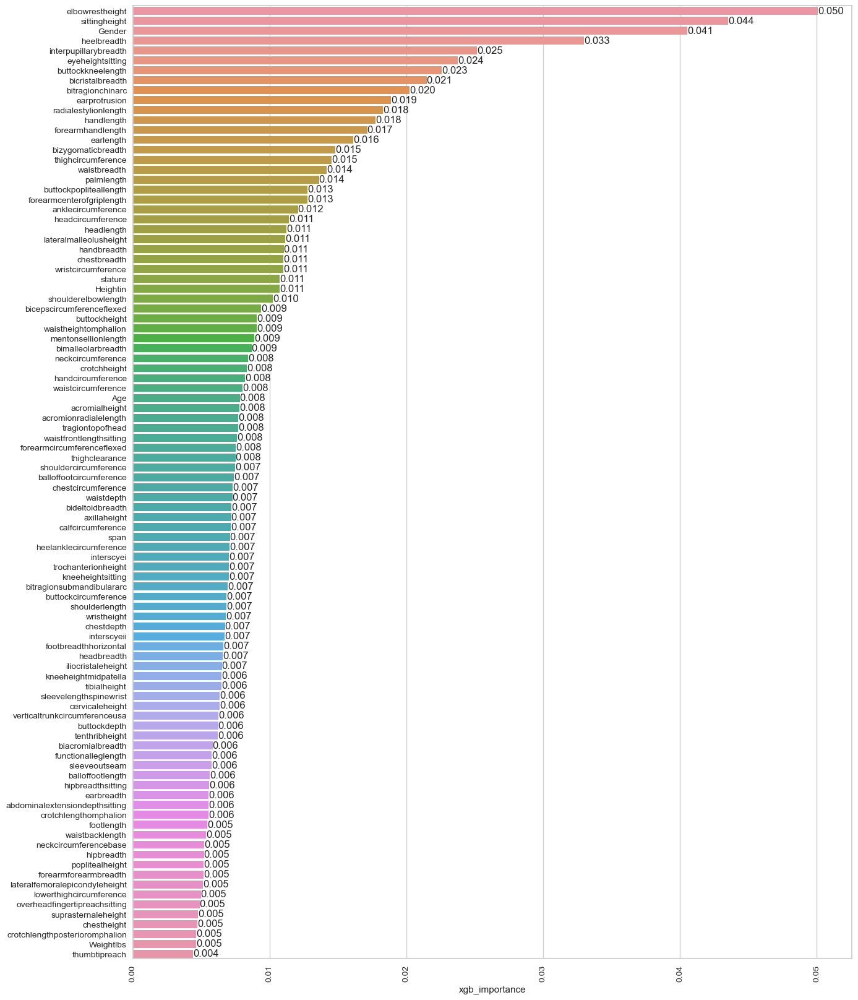

In [118]:
plt.figure(figsize=(15,20))
ax = sns.barplot(data=xgb_imp_feats, 
                 y=xgb_imp_feats.index,
                 x='xgb_importance')
ax.bar_label(ax.containers[0],fmt="%.3f")
plt.xticks(rotation=90);

**Evaluating ROC Curves and AUC**

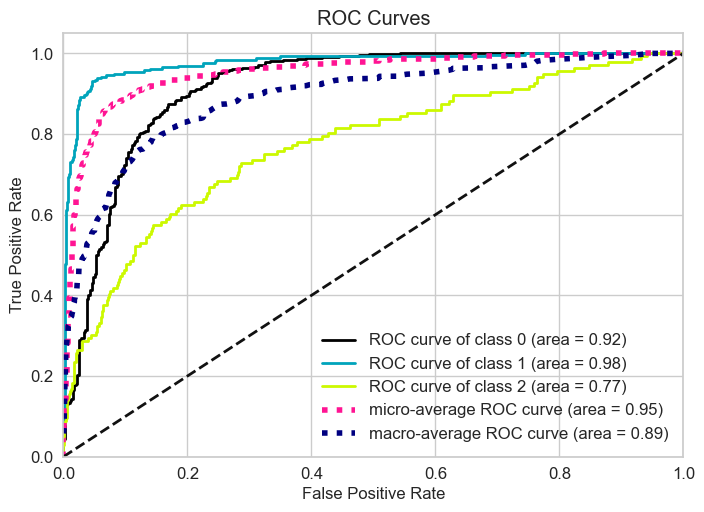

In [120]:
from scikitplot.metrics import plot_roc, precision_recall_curve

y_pred_proba = xgb_grid.predict_proba(X_test)
    
plot_roc(y_test, y_pred_proba)
plt.show();

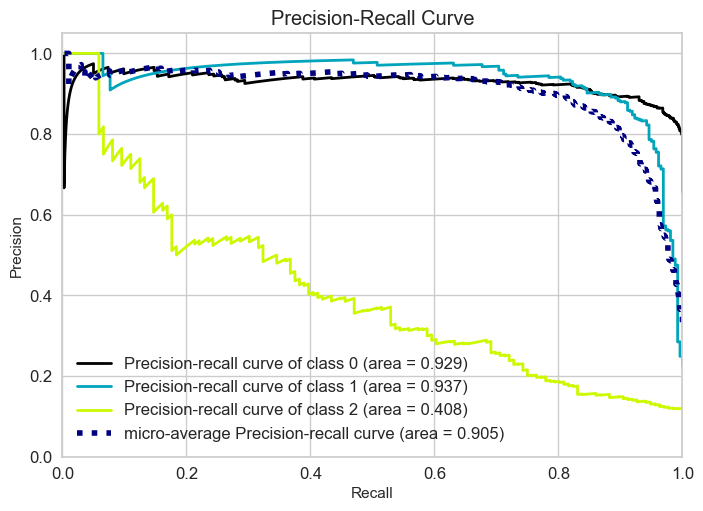

In [121]:
from scikitplot.metrics import plot_precision_recall

model = XGBClassifier(n_estimators=200,
                      colsample_bytree=1,
                      subsample=0.8,
                      learning_rate=0.2,
                      max_depth= 4)

model.fit(X_train, y_train)

y_pred_proba = model.predict_proba(X_test)
    
plot_precision_recall(y_test, y_pred_proba)
plt.show();

As seen, XGBoost also performs well for the first 2 classes, however it also performs poorly for the last class.

# Result:

We have performed logistic regression, Support vector machine, random forest and XGBoost algroithms so far. Each algorithm has been built both as vanilla model and then with best hyperparameters (gridsearch). Logistic regression (vanilla), SVC (gridsearchcv) and XGBoost (gridsearchcv) have been the algorithms with highest performances. However, any model could not predict class 3 efficiently and they all performed poorly. 

ROC AUC and precision recall curve values are over 90% for the first 2 classes with higher observations in each algorithm. However, any model could pass 50% for class 3. 

Overfitting is another main prblem for the models except Logistic regression and SVM. Logistic regression and SVM have been the algorithms which can avoid overfitting.

All in all, this model should be rebuilt by trying to find a balance inter classes. For this purpose, SMOTE and random sample techniques are going to be performed below and then the data is going to be remodelled.

---
---

# SMOTE
https://machinelearningmastery.com/smote-oversampling-for-imbalanced-classification/

##  Smote implement

In [229]:
# !pip install imblearn

In [51]:
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from imblearn.pipeline import Pipeline

## SVC Over/Under Sampling

In [126]:
df.DODRace.value_counts()

1    3792
2    1298
3     679
Name: DODRace, dtype: int64

**1) SVC OVERSAMPLING**

In [302]:
# Separate the features and target
X_sm = df.drop("DODRace", axis=1)
y_sm = df["DODRace"]

# Instantiate the SMOTE algorithm
smote = SMOTE(sampling_strategy={1: 3792, 2: 1298, 3: 1350}, random_state=42)

# Resample the data using SMOTE
X_resampled, y_resampled = smote.fit_resample(X_sm, y_sm)

# Combine the resampled features and target into a new data frame
new_df = pd.concat([pd.DataFrame(X_resampled), pd.DataFrame(y_resampled, columns=["DODRace"])], axis=1)

# Assign the balanced features and target arrays to X_resampled and y_resampled
X_resampled = new_df.drop("DODRace", axis=1)
y_resampled = new_df["DODRace"]

# Split the resampled data into train and test sets
X_train_resampled, X_test_resampled, y_train_resampled, y_test_resampled = train_test_split(X_resampled, y_resampled, stratify=y_resampled, test_size=0.2, random_state=42)

# Instantiate SVM model with linear kernel
svm = SVC(kernel='linear', random_state=42)

# Fit the SVM model on the resampled data
svm.fit(X_train_resampled, y_train_resampled)

SVC(kernel='linear', random_state=42)

In [303]:
# check evaluation metrics and scores
eval_metric(svm, X_train_resampled, y_train_resampled, X_test_resampled, y_test_resampled)

Test_Set
[[675   9  74]
 [ 27 221  12]
 [107  19 144]]
              precision    recall  f1-score   support

           1       0.83      0.89      0.86       758
           2       0.89      0.85      0.87       260
           3       0.63      0.53      0.58       270

    accuracy                           0.81      1288
   macro avg       0.78      0.76      0.77      1288
weighted avg       0.80      0.81      0.80      1288


Train_Set
[[2803   19  212]
 [  65  916   57]
 [ 343   68  669]]
              precision    recall  f1-score   support

           1       0.87      0.92      0.90      3034
           2       0.91      0.88      0.90      1038
           3       0.71      0.62      0.66      1080

    accuracy                           0.85      5152
   macro avg       0.83      0.81      0.82      5152
weighted avg       0.85      0.85      0.85      5152



**grid search SMOTE-SVM**

In [304]:
# find the best hyperparameters with gridsearch
param_grid = {#'SVC__C': [0.01, 0.05, 0.1], first round
              'SVC__C': [0.5, 1],
              'SVC__gamma': ["scale", "auto"], # 0.2
              'SVC__kernel': ['rbf', 'linear'] 
              }

In [305]:
from sklearn.metrics import balanced_accuracy_score

In [306]:


# set the operator order including scaler for pipeline and build SVC model by using pipeline
operations = [("scaler", StandardScaler()), ("SVC", SVC(probability=True))]
pipe_model = Pipeline(steps=operations)

# scores for imbalanced multiclass dataset-for CV
scoring = {
    'weighted_precision': make_scorer(precision_score, average='weighted', zero_division=0),
    'weighted_recall': make_scorer(recall_score, average='weighted', zero_division=0),
    'weighted_f1': make_scorer(f1_score, average='weighted', zero_division=0),
    'macro_f1': make_scorer(f1_score, average='macro', zero_division=0),
    'balanced_accuracy': make_scorer(balanced_accuracy_score)
}

# Perform grid search
SMOTE_svm = GridSearchCV(pipe_model, 
                          param_grid, 
                          scoring=scoring,
                          cv=10, 
                         refit='macro_f1',
                          n_jobs=-1,
                          return_train_score=True)

**Why are we still using "balanced_accuracy_score" as a performance metric for our model even after resampling the data to make it more balanced using SMOTE:**

The reason for this is that the balanced_accuracy_score metric takes into account the class imbalance in the data. This is important because accuracy alone can be misleading when evaluating models on imbalanced datasets, as a model that simply predicts the majority class for every example can still achieve high accuracy.

By using balanced_accuracy_score as the performance metric, we are ensuring that the model is evaluated based on its ability to correctly predict both the majority and minority classes. This will give us a more accurate measure of the model's performance on imbalanced datasets, even after resampling the data.

In [ ]:
%%time
# Fit the model on the balanced dataset
SMOTE_svm.fit(X_train_resampled, y_train_resampled)

In [308]:
SMOTE_svm.best_params_

{'SVC__C': 1, 'SVC__gamma': 'scale', 'SVC__kernel': 'rbf'}

In [309]:
# get the best estimators
SMOTE_svm.best_estimator_

Pipeline(steps=[('scaler', StandardScaler()),
                ('SVC', SVC(C=1, probability=True))])

In [310]:
# check overfitting
pd.DataFrame(SMOTE_svm.cv_results_).loc[SMOTE_svm.best_index_, ['mean_test_weighted_precision', 'mean_train_weighted_precision',
                                                             'mean_test_weighted_recall', 'mean_train_weighted_recall',
                                                             'mean_test_weighted_f1', 'mean_train_weighted_f1',
                                                             'mean_test_macro_f1','mean_train_macro_f1']]


mean_test_weighted_precision     0.855458
mean_train_weighted_precision    0.892861
mean_test_weighted_recall        0.857917
mean_train_weighted_recall         0.8929
mean_test_weighted_f1            0.850424
mean_train_weighted_f1           0.887886
mean_test_macro_f1               0.820939
mean_train_macro_f1              0.866827
Name: 4, dtype: object

In [311]:
# check evaluation metrics and scores
eval_metric(SMOTE_svm, X_train_resampled, y_train_resampled, X_test_resampled, y_test_resampled)

Test_Set
[[713  11  34]
 [ 18 231  11]
 [115  19 136]]
              precision    recall  f1-score   support

           1       0.84      0.94      0.89       758
           2       0.89      0.89      0.89       260
           3       0.75      0.50      0.60       270

    accuracy                           0.84      1288
   macro avg       0.83      0.78      0.79      1288
weighted avg       0.83      0.84      0.83      1288


Train_Set
[[2942   11   81]
 [  60  961   17]
 [ 327   49  704]]
              precision    recall  f1-score   support

           1       0.88      0.97      0.92      3034
           2       0.94      0.93      0.93      1038
           3       0.88      0.65      0.75      1080

    accuracy                           0.89      5152
   macro avg       0.90      0.85      0.87      5152
weighted avg       0.89      0.89      0.89      5152



In [312]:
# Cv check for overfitting control
operations = [("scaler", StandardScaler()), 
              ("SVC", SVC(C= 1, kernel= 'rbf', probability=True, class_weight="balanced"))]

In [313]:
# cross val - no overfitting
model = Pipeline(steps=operations)

scores = cross_validate(model, 
                        X_train_resampled, 
                        y_train_resampled, 
                        scoring=scoring, 
                        cv = 10,
                        return_train_score=True)
df_scores = pd.DataFrame(scores, index = range(1, 11))
df_scores.mean()[2:]

test_weighted_precision     0.851798
train_weighted_precision    0.896471
test_weighted_recall        0.843550
train_weighted_recall       0.890269
test_weighted_f1            0.846142
train_weighted_f1           0.892112
test_macro_f1               0.824172
train_macro_f1              0.879009
test_balanced_accuracy      0.835452
train_balanced_accuracy     0.892887
dtype: float64

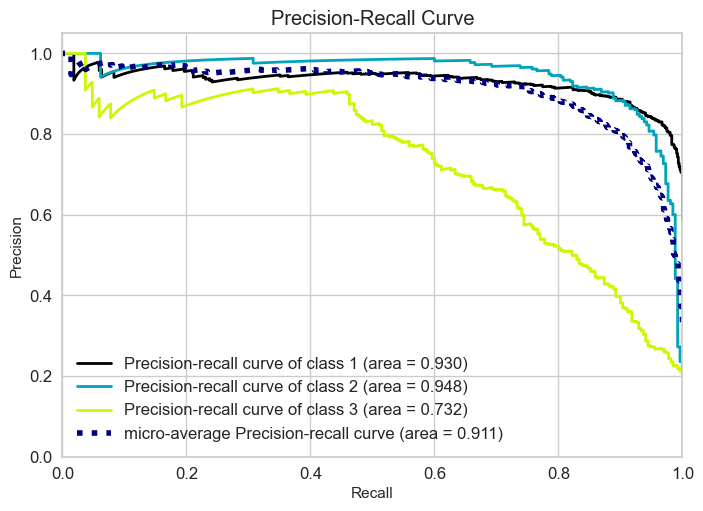

In [314]:
# Precision recall display for SVM model

operations = [("scaler", StandardScaler()), 
              ("SVC", SVC(C= 1, kernel= 'rbf', probability=True, 
                                                        class_weight="balanced"))]

model = Pipeline(steps=operations)

model.fit(X_train_resampled,y_train_resampled,)

y_pred_proba = model.predict_proba(X_test_resampled)
    
plot_precision_recall(y_test_resampled, y_pred_proba)
plt.show();

**2) SVM Under Sampling**

In [315]:
# Separate the features and target
X_svm_rus = df.drop("DODRace", axis=1)
y_svm_rus = df["DODRace"]

# Instantiate the RUS algorithm
rus_svm = RandomUnderSampler(sampling_strategy={1: 1500, 2: 1298, 3: 679}, random_state=42)

# Resample the data using RUS
X_resampled_svm, y_resampled_svm = rus_svm.fit_resample(X_svm_rus, y_svm_rus)

# Combine the resampled features and target into a new data frame
new_df = pd.concat([pd.DataFrame(X_resampled_svm), pd.DataFrame(y_resampled_svm, columns=["DODRace"])], axis=1)

# Assign the balanced features and target arrays to X_resampled and y_resampled
X_resampled_svm = new_df.drop("DODRace", axis=1)
y_resampled_svm = new_df["DODRace"]

# Split the resampled data into train and test sets
X_train_svm, X_test_svm, y_train_svm, y_test_svm = train_test_split(X_resampled_svm, y_resampled_svm, stratify=y_resampled_svm, test_size=0.2, random_state=42)

# Shift class labels down by one
y_train_svm = np.array([label - 1 for label in y_train_svm])
y_test_svm = np.array([label - 1 for label in y_test_svm])

# Instantiate the SVM algorithm
svc = SVC()

# Fit the model on the resampled data
svc.fit(X_train_svm, y_train_svm)

SVC()

In [316]:
# check evaluation metrics and scores
eval_metric(svc, X_train_svm, y_train_svm, X_test_svm, y_test_svm)

Test_Set
[[277  23   0]
 [ 71 189   0]
 [ 99  37   0]]
              precision    recall  f1-score   support

           0       0.62      0.92      0.74       300
           1       0.76      0.73      0.74       260
           2       0.00      0.00      0.00       136

    accuracy                           0.67       696
   macro avg       0.46      0.55      0.49       696
weighted avg       0.55      0.67      0.60       696


Train_Set
[[1102   98    0]
 [ 222  816    0]
 [ 411  132    0]]
              precision    recall  f1-score   support

           0       0.64      0.92      0.75      1200
           1       0.78      0.79      0.78      1038
           2       0.00      0.00      0.00       543

    accuracy                           0.69      2781
   macro avg       0.47      0.57      0.51      2781
weighted avg       0.57      0.69      0.62      2781



In [ ]:
# no need to girdsearch.

## Xgboost Over/ Under Sampling

**1) 1.1 XGBoost Oversampling with SMOTE - class 3= 1300**

In [234]:
df.DODRace.value_counts()

1    3792
2    1298
3     679
Name: DODRace, dtype: int64

In [240]:
# Separate the features and target
X_sm = df.drop("DODRace", axis=1)
y_sm = df["DODRace"]


# Instantiate the SMOTE algorithm
smote = SMOTE(sampling_strategy={1: 3792, 2: 1298, 3: 1350}, random_state=42)

# Resample the data using SMOTE
X_resampled, y_resampled = smote.fit_resample(X_sm, y_sm)

# Combine the resampled features and target into a new data frame
new_df = pd.concat([pd.DataFrame(X_resampled), pd.DataFrame(y_resampled, columns=["DODRace"])], axis=1)

# Assign the balanced features and target arrays to X_resampled and y_resampled
X_resampled = new_df.drop("DODRace", axis=1)
y_resampled = new_df["DODRace"]

# Split the resampled data into train and test sets
X_train_resampled, X_test_resampled, y_train_resampled, y_test_resampled = train_test_split(X_resampled, y_resampled, stratify=y_resampled, test_size=0.2, random_state=42)



In [237]:
y_sm.unique()

array([1, 2, 3])

In [241]:
y_resampled.shape

(6440,)

In [243]:
# Shift class labels down by one
y_train_resampled = np.array([label - 1 for label in y_train_resampled])
y_test_resampled = np.array([label - 1 for label in y_test_resampled])

xgb.fit(X_train_resampled, y_train_resampled)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=None, num_parallel_tree=None,
              objective='multi:softprob', predictor=None, ...)

In [244]:
# Vanilla XGBoost
eval_metric(xgb, X_train_resampled, y_train_resampled, X_test_resampled, y_test_resampled)

Test_Set
[[722  12  24]
 [ 26 224  10]
 [ 77  10 183]]
              precision    recall  f1-score   support

           0       0.88      0.95      0.91       758
           1       0.91      0.86      0.89       260
           2       0.84      0.68      0.75       270

    accuracy                           0.88      1288
   macro avg       0.88      0.83      0.85      1288
weighted avg       0.88      0.88      0.87      1288


Train_Set
[[3034    0    0]
 [   0 1038    0]
 [   0    0 1080]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      3034
           1       1.00      1.00      1.00      1038
           2       1.00      1.00      1.00      1080

    accuracy                           1.00      5152
   macro avg       1.00      1.00      1.00      5152
weighted avg       1.00      1.00      1.00      5152



In [245]:
# cross val
model = XGBClassifier(random_state=42)

scoring = {
    'weighted_precision': make_scorer(precision_score, average='weighted', zero_division=0),
    'weighted_recall': make_scorer(recall_score, average='weighted', zero_division=0),
    'weighted_f1': make_scorer(f1_score, average='weighted', zero_division=0),
    'macro_f1': make_scorer(f1_score, average='macro', zero_division=0)
}

scores = cross_validate(model,
                        X_train_resampled, y_train_resampled, 
                        scoring=scoring,
                        cv = 10, 
                        return_train_score=True)
df_scores = pd.DataFrame(scores, index = range(1, 11))
df_scores.mean()[2:]

test_weighted_precision     0.870703
train_weighted_precision    1.000000
test_weighted_recall        0.870730
train_weighted_recall       1.000000
test_weighted_f1            0.867319
train_weighted_f1           1.000000
test_macro_f1               0.843140
train_macro_f1              1.000000
dtype: float64

**with gridsearch**

In [ ]:
%%time
# find the best hyperparameters with gridsearch
param_grid = {"xgb__n_estimators":[50, 100, 200],
              'xgb__max_depth':[2,3], 
              "xgb__learning_rate": [0.1, 0.2],
              "xgb__subsample":[0.5, 0.8, 1], 
              "xgb__colsample_bytree":[0.5,0.7, 1]}

# set the operator order including scaler for pipeline and build XGBClassifier model by using pipeline
operations = [("scaler", StandardScaler()), ("xgb", XGBClassifier(random_state=42))]
pipe_model = Pipeline(steps=operations)

# scores for imbalanced multiclass dataset-for CV
scoring = {
    'weighted_precision': make_scorer(precision_score, average='weighted', zero_division=0),
    'weighted_recall': make_scorer(recall_score, average='weighted', zero_division=0),
    'weighted_f1': make_scorer(f1_score, average='weighted', zero_division=0),
    'macro_f1': make_scorer(f1_score, average='macro', zero_division=0),
    'balanced_accuracy': make_scorer(balanced_accuracy_score)
}

# Perform grid search
SMOTE_XGB = GridSearchCV(pipe_model, 
                          param_grid, 
                          scoring=scoring,
                          cv=10, 
                          refit='macro_f1',
                          n_jobs=-1,
                          return_train_score=True)

# fit the model
SMOTE_XGB.fit(X_train_resampled, y_train_resampled)


In [247]:
SMOTE_XGB.best_params_


{'xgb__colsample_bytree': 1,
 'xgb__learning_rate': 0.2,
 'xgb__max_depth': 5,
 'xgb__n_estimators': 200,
 'xgb__subsample': 1}

In [248]:
SMOTE_XGB.best_estimator_

Pipeline(steps=[('scaler', StandardScaler()),
                ('xgb',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=1, early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy=None, importance_type=None,
                               interaction_constraints=None, learning_rate=0.2,
                               max_bin=None, max_cat_threshold=None,
                               max_cat_to_onehot=None, max_delta_step=None,
                               max_depth=5, max_leaves=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, n_estimators=200,
                               n_jobs=None, num_parallel_tree=None,
                               objective='multi:softprob', predictor=None, ...))])

In [249]:

pd.DataFrame(SMOTE_XGB.cv_results_).loc[SMOTE_XGB.best_index_, ['mean_test_weighted_precision', 'mean_train_weighted_precision',
                                                             'mean_test_weighted_recall', 'mean_train_weighted_recall',
                                                             'mean_test_weighted_f1', 'mean_train_weighted_f1',
                                                             'mean_test_macro_f1','mean_train_macro_f1']]

mean_test_weighted_precision     0.875124
mean_train_weighted_precision         1.0
mean_test_weighted_recall        0.875386
mean_train_weighted_recall            1.0
mean_test_weighted_f1            0.872284
mean_train_weighted_f1                1.0
mean_test_macro_f1               0.849194
mean_train_macro_f1                   1.0
Name: 161, dtype: object

In [250]:
y_pred = SMOTE_XGB.predict(X_test_resampled)
y_pred_proba = SMOTE_XGB.predict_proba(X_test_resampled)

In [251]:
# XGBoost with best parameters
eval_metric(SMOTE_XGB, X_train_resampled, y_train_resampled, X_test_resampled, y_test_resampled)

Test_Set
[[718  11  29]
 [ 24 226  10]
 [ 76  12 182]]
              precision    recall  f1-score   support

           0       0.88      0.95      0.91       758
           1       0.91      0.87      0.89       260
           2       0.82      0.67      0.74       270

    accuracy                           0.87      1288
   macro avg       0.87      0.83      0.85      1288
weighted avg       0.87      0.87      0.87      1288


Train_Set
[[3034    0    0]
 [   0 1038    0]
 [   0    0 1080]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      3034
           1       1.00      1.00      1.00      1038
           2       1.00      1.00      1.00      1080

    accuracy                           1.00      5152
   macro avg       1.00      1.00      1.00      5152
weighted avg       1.00      1.00      1.00      5152



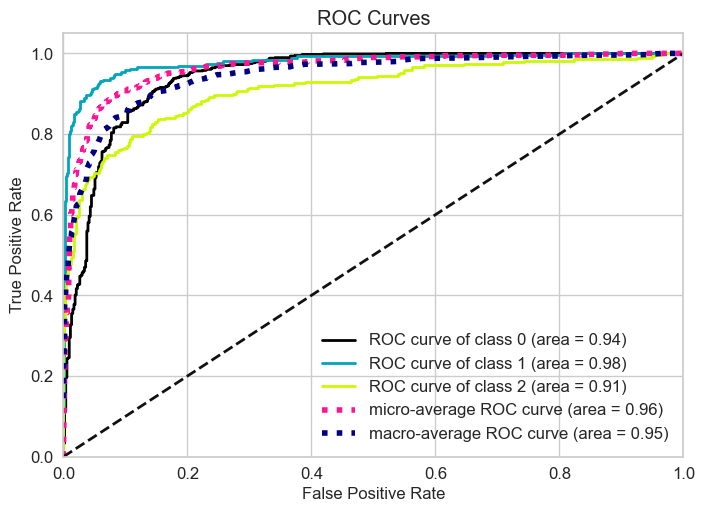

In [252]:

y_pred_proba = SMOTE_XGB.predict_proba(X_test_resampled)
    
plot_roc(y_test_resampled, y_pred_proba)
plt.show();

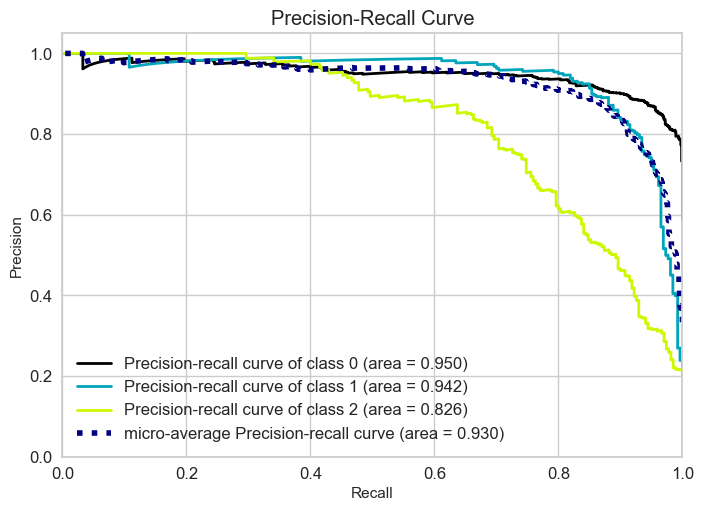

In [253]:

model = XGBClassifier(n_estimators=200,
                      colsample_bytree=1,
                      subsample=1,
                      learning_rate=0.2,
                      max_depth= 5)

model.fit(X_train_resampled, y_train_resampled)

y_pred_proba = model.predict_proba(X_test_resampled)
    
plot_precision_recall(y_test_resampled, y_pred_proba)
plt.show();

**RandomUnderSample XGBOOST**

In [256]:
df.DODRace.value_counts()

1    3792
2    1298
3     679
Name: DODRace, dtype: int64

In [265]:
# Separate the features and target
X_rus = df.drop("DODRace", axis=1)
y_rus = df["DODRace"]

# Instantiate the RUS algorithm
rus = RandomUnderSampler(sampling_strategy={1: 1500, 2: 1298, 3: 679}, random_state=42)

# Resample the data using RUS
X_resampled_rus, y_resampled_rus = rus.fit_resample(X_rus, y_rus)

# Combine the resampled features and target into a new data frame
new_df = pd.concat([pd.DataFrame(X_resampled_rus), pd.DataFrame(y_resampled_rus, columns=["DODRace"])], axis=1)

# Assign the balanced features and target arrays to X_resampled and y_resampled
X_resampled_rus = new_df.drop("DODRace", axis=1)
y_resampled_rus = new_df["DODRace"]

# Split the resampled data into train and test sets
X_train_rus, X_test_rus, y_train_rus, y_test_rus = train_test_split(X_resampled_rus, y_resampled_rus, stratify=y_resampled_rus, test_size=0.2, random_state=42)

# Shift class labels down by one
y_train_rus = np.array([label - 1 for label in y_train_rus])
y_test_rus = np.array([label - 1 for label in y_test_rus])

# Fit your model on the resampled data
xgb.fit(X_train_rus, y_train_rus)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=None, num_parallel_tree=None,
              objective='multi:softprob', predictor=None, ...)

In [266]:
# Vanilla XGBoost RandomUnder Sampler
eval_metric(xgb, X_train_rus, y_train_rus, X_test_rus, y_test_rus)

Test_Set
[[149  10  21]
 [ 12 237  11]
 [ 33  26  77]]
              precision    recall  f1-score   support

           0       0.77      0.83      0.80       180
           1       0.87      0.91      0.89       260
           2       0.71      0.57      0.63       136

    accuracy                           0.80       576
   macro avg       0.78      0.77      0.77       576
weighted avg       0.80      0.80      0.80       576


Train_Set
[[ 720    0    0]
 [   0 1038    0]
 [   0    0  543]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       720
           1       1.00      1.00      1.00      1038
           2       1.00      1.00      1.00       543

    accuracy                           1.00      2301
   macro avg       1.00      1.00      1.00      2301
weighted avg       1.00      1.00      1.00      2301



- Evaluation metrics 
https://towardsdatascience.com/comprehensive-guide-on-multiclass-classification-metrics-af94cfb83fbd

In [254]:
from sklearn.metrics import matthews_corrcoef

matthews_corrcoef(y_test_resampled, y_pred)

0.774916984757445

In [255]:
from sklearn.metrics import cohen_kappa_score

cohen_kappa_score(y_test_resampled, y_pred)

0.7718334809565988

#  SHAP

https://towardsdatascience.com/shap-explain-any-machine-learning-model-in-python-24207127cad7

In [227]:
# !pip install shap

In [ ]:
import shap
explainer = shap.Explainer(log_model,X_train)
start_index = 203
end_index = 204
shap_values = explainer.shap_values(X_test[start_index:end_index])

In [ ]:
shap_values

In [ ]:
print(shap_values[0].shape)

(1, 232)


In [ ]:
# %% >> Visualize local predictions
shap.initjs()
# Force plot
prediction = log_model.predict(X_test[start_index:end_index])[0]
print(f"The log_model predicted: {prediction}")
shap.force_plot(explainer.expected_value[1],
                shap_values[1],
                X_test[start_index:end_index], # for values
                feature_names= X.columns,) 

In [ ]:
shap.summary_plot(shap_values, X_train,max_display=300,feature_names = X.columns)

# Before the Deployment 
- Choose the model that works best based on your chosen metric
- For final step, fit the best model with whole dataset to get better performance.
- And your model ready to deploy, dump your model and scaler.

**score with highest performance and without overfitting: SVC + SMOTE over sampled**

In [317]:
# check evaluation metrics and scores
eval_metric(SMOTE_svm, X_train_resampled, y_train_resampled, X_test_resampled, y_test_resampled)
# overfit will be checked below with cross validation

Test_Set
[[713  11  34]
 [ 18 231  11]
 [115  19 136]]
              precision    recall  f1-score   support

           1       0.84      0.94      0.89       758
           2       0.89      0.89      0.89       260
           3       0.75      0.50      0.60       270

    accuracy                           0.84      1288
   macro avg       0.83      0.78      0.79      1288
weighted avg       0.83      0.84      0.83      1288


Train_Set
[[2942   11   81]
 [  60  961   17]
 [ 327   49  704]]
              precision    recall  f1-score   support

           1       0.88      0.97      0.92      3034
           2       0.94      0.93      0.93      1038
           3       0.88      0.65      0.75      1080

    accuracy                           0.89      5152
   macro avg       0.90      0.85      0.87      5152
weighted avg       0.89      0.89      0.89      5152



In [318]:
# Cv check for overfitting control
operations = [("scaler", StandardScaler()), 
              ("SVC", SVC(C= 1, kernel= 'rbf', probability=True, class_weight="balanced"))]

# rebuild the model with best hyperparameters found during gridsearch
model = Pipeline(steps=operations)

scores = cross_validate(model, 
                        X_train_resampled, 
                        y_train_resampled, 
                        scoring=scoring, 
                        cv = 10,
                        return_train_score=True)
df_scores = pd.DataFrame(scores, index = range(1, 11))
df_scores.mean()[2:]
# no overfitting

test_weighted_precision     0.851798
train_weighted_precision    0.896471
test_weighted_recall        0.843550
train_weighted_recall       0.890269
test_weighted_f1            0.846142
train_weighted_f1           0.892112
test_macro_f1               0.824172
train_macro_f1              0.879009
test_balanced_accuracy      0.835452
train_balanced_accuracy     0.892887
dtype: float64

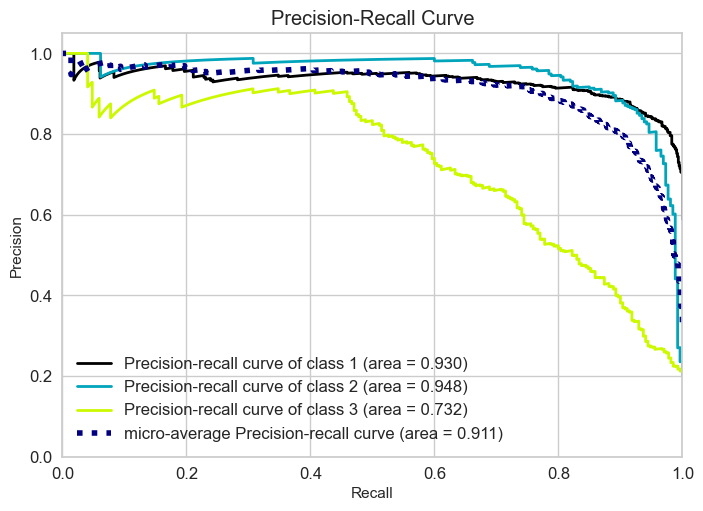

In [319]:
# Precision recall display for SVM model

operations = [("scaler", StandardScaler()), 
              ("SVC", SVC(C= 1, kernel= 'rbf', probability=True, 
                                                        class_weight="balanced"))]

model = Pipeline(steps=operations)

model.fit(X_train_resampled,y_train_resampled,)

y_pred_proba = model.predict_proba(X_test_resampled)
    
plot_precision_recall(y_test_resampled, y_pred_proba)
plt.show();

**Final Model**

In [320]:
# set the operator order including scaler for pipeline and build SVC model by using pipeline
operations = [("scaler", StandardScaler()), 
              ("SVC", SVC(C= 1, kernel= 'rbf', probability=True, class_weight="balanced"))]
pipe_model = Pipeline(steps=operations)

pipe_model.fit(X_sm, y_sm)  # fit entire model for final model

Pipeline(steps=[('scaler', StandardScaler()),
                ('SVC', SVC(C=1, class_weight='balanced', probability=True))])

In [321]:
# dump model and save to local
import pickle
pickle.dump(pipe_model, open("final_soldier_model", 'wb'))
# write binary (wb) - save to local

In [322]:
# read and call model
soldier_model = pickle.load(open("final_soldier_model", "rb"))

___

<p style="text-align: center;"><img src="https://docs.google.com/uc?id=1lY0Uj5R04yMY3-ZppPWxqCr5pvBLYPnV" class="img-fluid" alt="CLRSWY"></p>

___